<a href="https://colab.research.google.com/github/askolesov0608/CV_NV/blob/main/99CVLab6_Part1Comp_Tests.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load and setup

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
from google.colab import files

In [3]:
!cp /content/gdrive/MyDrive/CV/Lab6/visualPercepUtils.py /content #copy file

In [4]:
#!cp -r /content/gdrive/MyDrive/CV/Lab6/ /content #copy all folder

In [5]:
import os
import time

source_dir = '/content/gdrive/MyDrive/CV/Lab6/'
destination_dir = '/content/Lab6/'

# Функция для копирования файлов или папок
def copy_files(source_dir, destination_dir):
    os.system(f"cp -r {source_dir} {destination_dir}")

# Проверка наличия папки Lab6 в папке content
def check_copy_completion(destination_dir):
    return os.path.exists(destination_dir)

# Копирование файлов или папок
copy_files(source_dir, destination_dir)

# Проверка завершения копирования и повторение через время, если необходимо
while not check_copy_completion(destination_dir):
    print("Копирование не завершено, повтор через 60 секунд...")
    time.sleep(60)  # Повтор через 60 секунд
    copy_files(source_dir, destination_dir)

print("Копирование завершено.")

Копирование завершено.


In [6]:
import numpy as np
from scipy import signal

from skimage.data import stereo_motorcycle, moon, astronaut, camera
from skimage.transform import SimilarityTransform, warp

from skimage.color import rgb2gray
import matplotlib.pylab as plt
from skimage.filters import gaussian
#from skimage.registration import optical_flow_ilk as LK
from mpl_toolkits.axes_grid1 import ImageGrid
from PIL import Image
from skimage.transform import rescale

import cv2
from scipy import ndimage as ndi
from copy import deepcopy

import glob # Модуль для поиска файлов в директориях с помощью шаблонов в Unix стиле. Например, glob.glob('*.png')
import visualPercepUtils as vpu






In [7]:
#files.upload()

# Code provided from the teacher

## Inputs

In [8]:
#пути к директориям для входных и выходных файлов.
path_input = './Lab6/imgs-P6/'
path_output = './Lab6/imgs-out-P6/'

In [9]:
ls

gdrive/  Lab6/  __pycache__/  sample_data/  visualPercepUtils.py


In [10]:
# Получаем список файлов в директории
files = os.listdir(path_input)

# Выводим список файлов
for file in files:
    print(file)

taxi
corridor
traffic


## Def functions

In [11]:
def display_image_pyr(imgs):
    N = len(imgs)
    m = int(np.sqrt(N))
    n = N // m
    if (m * n < N):
        m += 1
    fig = plt.figure(figsize=(8., 8.))

    for i, im in enumerate(imgs):
        fig.add_subplot(m, n, i + 1)
        plt.imshow(im, cmap='gray')
        plt.title("size: " + str(im.shape))

    plt.show(block=True)

In [12]:
def display_optic_flow(I1, I2, u, v, title=""):
    fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(8, 4))

    # --- Sequence image sample

    ax0.imshow(I1, cmap='gray')
    ax0.set_title(r"$I_1$")
    ax0.set_axis_off()

    ax1.imshow(I2, cmap='gray')
    ax1.set_title(r"$I_2$")
    ax1.set_axis_off()

    nvec = 20  # Number of vectors to be displayed along each image dimension
    nl, nc = I1.shape
    step = max(nl // nvec, nc // nvec)

    y, x = np.mgrid[:nl:step, :nc:step]
    u_ = u[::step, ::step]
    v_ = v[::step, ::step]

    norm = np.sqrt(u ** 2 + v ** 2)
    angle = np.arctan2(v,u)
    ax2.imshow(angle)

    widths = np.linspace(0, 10, u.size)
    ax2.quiver(x, y, u_, v_, color='w', units='dots',
               angles='xy', scale_units='xy', lw=2, headaxislength=30, headlength=30, headwidth=15, edgecolors='w')#linewidth=2, edgecolors='w')
    ax2.set_title("Optical flow orientation and vector field")
    ax2.set_axis_off()
    fig.tight_layout()

    plt.suptitle(title)
    plt.show(block=True)

In [13]:
def get_real_sequence_image_pair(seq,t0,t1=None):

    assert seq in ['taxi','traffic','corridor'] # make sure the chosen sequence is available

    if t1 is None:
        t1 = t0 + 1 # if not provided the second frame, assume it is the following one

    valid_frame_ranges = {'taxi': [0, 40], 'traffic': [0, 48], 'corridor': [0, 9]}

    # make sure the chosen frames are available for the chosen sequence
    assert valid_frame_ranges[seq][1] >= t0 >= valid_frame_ranges[seq][0]
    assert valid_frame_ranges[seq][1] >= t1 >= valid_frame_ranges[seq][0]

    # read the corresponding frames
    I1, I2 = [Image.open("./Lab6/imgs-P6/" + seq + "/" + seq + "_frame" +
                         str(t).zfill(3) + ".png").convert('L') for t in [t0, t1]]

    # we can downscale for either computational reasons or to have smaller motions
    resize_factor = 0.5  # you can experiment with different values

    I1 = I1.resize([int(resize_factor * s) for s in I1.size])
    I2 = I2.resize([int(resize_factor * s) for s in I2.size])

    I1 = np.array(I1) / 255
    I2 = np.array(I2) / 255

    return I1, I2

In [14]:
def get_synthetic_sequence_image_pair(seq, translation=(0,0), rotation=0, scale=1):
    assert seq in ['moon','astronaut','camera'] # make sure the chosen sequence is available
    # moon: low-contrast image of the moon
    # astronaut: color image of astronaut
    # camera: gray-level image of cameraman
    image0 = eval(seq)()
    if (len(image0.shape) == 3):
        image0 = rgb2gray(image0)
    I1 = np.array(image0)
    if (I1.dtype == "uint8"):
        I1 = I1 / 255.0

    # apply synthetic transformation
    shift_y, shift_x = (np.array(I1.shape[:2]) - 1) / 2.  # image center
    tf_shift = SimilarityTransform(translation=[-shift_x, -shift_y])
    tf_shift_inv = SimilarityTransform(translation=[shift_x, shift_y])

    tf_transf = SimilarityTransform(scale= scale, rotation=np.deg2rad(rotation), translation=translation)
    I2 = warp(I1, (tf_shift + (tf_transf + tf_shift_inv)).inverse, preserve_range=True)

    return I1, I2

In [15]:
def display_magnitude_and_orientation(magnitude, angle):
    # display the magnitude of OF
    fig, ax = plt.subplots()
    plt.hist(magnitude[magnitude>0].flatten(), 30, label="LK, seq="+seq, fc=(0, 0, 1, 0.2))
    plt.legend()
    plt.show(block=True)

    # display the orientation of OF
    plt.imshow(angle,cmap='hsv') # cyclic maps: 'twilight', 'twilight_shifted', 'hsv'
    plt.title("Orientation")
    plt.show(block=True)

In [16]:
def optical_flow(I1, I2, window_size, tau=0.01, bDisplay=False):

    kernel_x = np.array([[-1., 1.], [-1., 1.]])

  #Your code (1): kernels for y
    kernel_y = kernel_x.T # Transpouse for Vertical

  #Your code (1): kernels for t
    kernel_size = 4
    kernel_t = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size**2)

    w = int(window_size/2) # window_size is odd, all the pixels with offset in between [-w, w] are inside the window

    I1g = gaussian(I1, sigma=5, truncate=1/5)
    I2g = gaussian(I2, sigma=5, truncate=1/5)

    # Implement Lucas-Kanade
    # for each image point, calculate I_x, I_y, I_t
    mode = 'same'
    fx = signal.convolve2d(I1g, kernel_x, boundary='symm', mode=mode)

 #fy = # your code (1)
    fy = signal.convolve2d(I1, kernel_y, mode='same', boundary='symm')

 #ft = # your code (1)
    ft1 = signal.convolve2d(I1g, kernel_t, boundary='symm', mode=mode)
    ft2 = signal.convolve2d(I2g, kernel_t, boundary='symm', mode=mode)
    ft = ft1 - ft2


    if bDisplay:
        for f in [fx,fy,ft]:
            plt.imshow(f,cmap='gray')
            plt.show(block=True)

    u = np.zeros(I1g.shape)
    v = np.zeros(I1g.shape)

    # iterate for each image window of size window_size * window_size
    M,N = I1g.shape
    for i in range(w, M-w):
        for j in range(w, N-w): #Создаем массив части изображения
            Ix = fx[i-w:i+w+1, j-w:j+w+1].flatten() # fx нашли вертикаль через конв с ядром [-1., 1.], [-1., 1.]
            Iy = fy[i-w:i+w+1, j-w:j+w+1].flatten() # fy нашли горизонталь [-1., -1.], [1., 1.]
            It = ft[i-w:i+w+1, j-w:j+w+1].flatten() # ft  просто усреднили изображение по среднему фильтру 4х4

            #AtA = # your code (2)  #A = np.vstack((Ix, Iy)) -- A=A.T
            A = np.vstack((Ix, Iy)).T
            AtA = np.dot(A.T, A)

             #Atb = # your code (2)
            b = -It.reshape(-1, 1)   # В одинстолбец [Ix, Iy][u / V] = -It так как их тейлора вывели что все производные можно уюрать оставив только I(x,y,t)
            Atb = np.dot(A.T, b)


             # your code (4)
             #if # your code (4)

            if np.linalg.matrix_rank(AtA) == 2 and np.min(np.linalg.eigvals(AtA)) > tau:
               nu, residuals, rank, s = np.linalg.lstsq(AtA, Atb, rcond=None)
               u[i, j] = nu[0, 0]  # Извлекаем первый элемент из первой строки
               v[i, j] = nu[1, 0]  # Извлекаем второй элемент из первой строки, если он есть
               #print(f"  Optical flow components - u: {u[i,j]}, v: {v[i,j]}")
            else:
                u[i, j] = 0
                v[i, j] = 0

    return u,v


## Start script

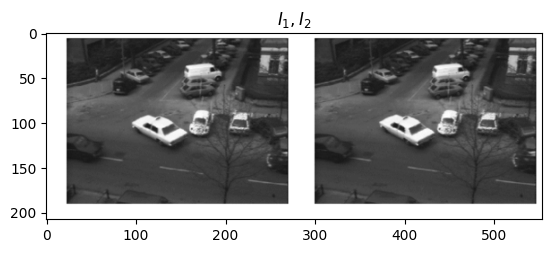

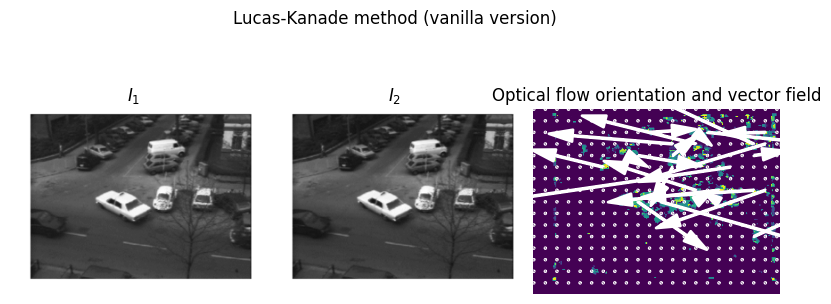

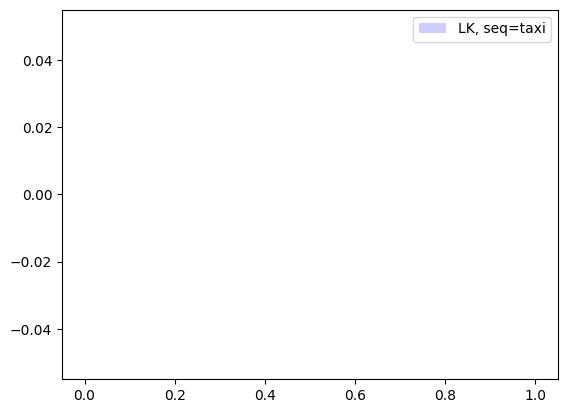

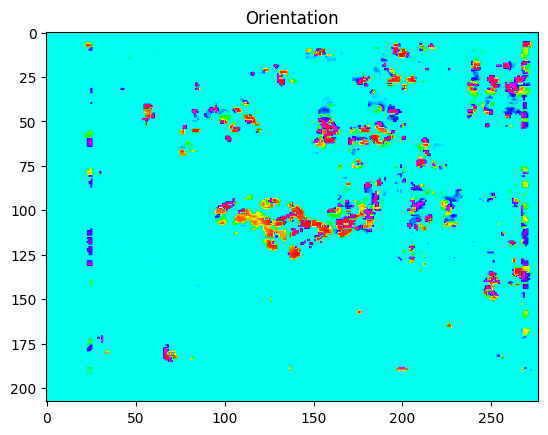

In [17]:
if __name__ == "__main__":

    bSyntheticTransf = False
    bCrop = False

    if not bSyntheticTransf:
        seq = 'traffic'
        seq = 'corridor'
        seq = 'taxi'
        I1, I2 = get_real_sequence_image_pair(seq,10)
    else:
        seq = 'moon'
        seq = 'astronaut'
        seq = 'camera'
        scale = 1 # 1=no change, >1: zoom in, <1: <zoom out (e.g.
        rotation = -30.0 # in degrees, positive or negative for clockwise or counter-clockwise, respectively
        translation = (0.0, 0.0) # (tx, ty) in pixel, positive or negative
        I1, I2 = get_synthetic_sequence_image_pair(seq, translation=translation, rotation=rotation, scale=scale)


    if bCrop: # if we want to work only on some smaller part of the input images I1, I2
        y1, y2 = 200, 400
        x1, x2 = 200, 400
        I1 = I1[y1:y2, x1:x2]
        I2 = I2[y1:y2, x1:x2]

    # display the images before computing the optic flow
    plt.title(r"$I_1, I_2$")
    plt.imshow(np.hstack((I1,I2)),cmap='gray')
    plt.show(block=True)

    # You are asked to experiment with different values for these hyperparameters
    window_size = 3
    tau = 0.01

    # Running the LK method
    #u, v = np.zeros_like(I1), np.zeros_like(I1) # comment out this line with the proper call (below) when you are ready
    u,v = optical_flow(I1, I2, window_size=window_size, tau=tau)
    display_optic_flow(I1, I2, -u, -v, "Lucas-Kanade method (vanilla version)")

    # Compute the magnitude and orientation of OF
    magnitude = np.zeros_like(u) # replace with your code
    angle = np.arctan2(v,u)

    display_magnitude_and_orientation(magnitude, angle)


## Testing directory and loads

In [18]:
ls

gdrive/  Lab6/  __pycache__/  sample_data/  visualPercepUtils.py


In [19]:
folder_path = './Lab6/imgs-P6/'
path_output = './Lab6/imgs-out-P6/'


In [20]:
# Получаем список файлов в директории
files = os.listdir(folder_path)

# Выводим список файлов
for file in files:
    print(file)

taxi
corridor
traffic


In [21]:
ls ./Lab6/imgs-P6/traffic

traffic_frame000.png  traffic_frame013.png  traffic_frame026.png  traffic_frame039.png
traffic_frame001.png  traffic_frame014.png  traffic_frame027.png  traffic_frame040.png
traffic_frame002.png  traffic_frame015.png  traffic_frame028.png  traffic_frame041.png
traffic_frame003.png  traffic_frame016.png  traffic_frame029.png  traffic_frame042.png
traffic_frame004.png  traffic_frame017.png  traffic_frame030.png  traffic_frame043.png
traffic_frame005.png  traffic_frame018.png  traffic_frame031.png  traffic_frame044.png
traffic_frame006.png  traffic_frame019.png  traffic_frame032.png  traffic_frame045.png
traffic_frame007.png  traffic_frame020.png  traffic_frame033.png  traffic_frame046.png
traffic_frame008.png  traffic_frame021.png  traffic_frame034.png  traffic_frame047.png
traffic_frame009.png  traffic_frame022.png  traffic_frame035.png  traffic_frame048.png
traffic_frame010.png  traffic_frame023.png  traffic_frame036.png
traffic_frame011.png  traffic_frame024.png  traffic_frame037.png


In [22]:
filename = "traffic_frame011.png"

In [23]:
folder_path = './Lab6/imgs-P6/traffic'

In [24]:
path_input = os.path.join(folder_path, filename)
#path_input = path_input.strip()  # Удаление пробелов в начале и в конце строки
path_input

'./Lab6/imgs-P6/traffic/traffic_frame011.png'

In [25]:
test_image = Image.open(path_input)
print(test_image.size)

(512, 512)


array([[ 56,  53,  54, ...,  66,  81,  75],
       [ 61,  54,  53, ...,  56,  77,  75],
       [ 72,  60,  54, ...,  54,  72,  67],
       ...,
       [240, 159,  70, ...,  43,  69,  44],
       [245, 166,  57, ...,  50,  45,  47],
       [188, 138,  72, ...,  50,  69,  43]], dtype=uint8)
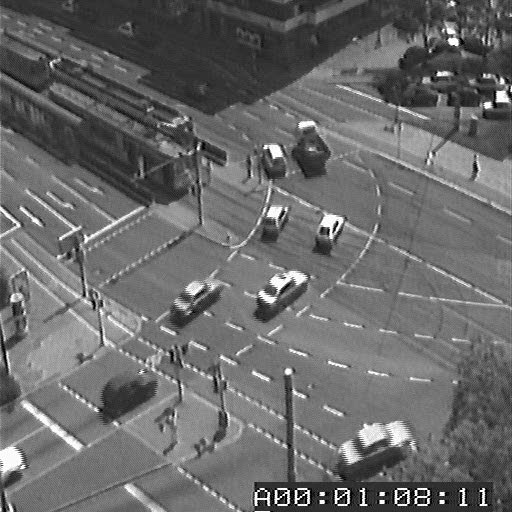

In [26]:
im = np.array(test_image.convert('L'))
im

# 1. Lucas-Kanade algorithm

### Our first task is to complete the function u,v = optical_flow(I1, I2, window_size, tau)

Шаги алгоритма Лукаса-Канаде:
1. **Вычисление градиентов:** Для каждого пикселя в изображении вычислите градиенты интенсивности по x и y, а также временной градиент между двумя последовательными кадрами.
2. **Сборка матрицы A:** Для каждого пикселя в окне размером `window_size` соберите матрицу A, используя градиенты. Элементы матрицы A обычно представляют собой суммы произведений градиентов по x и y в пределах окна.
3. **Вычисление $( A^T A $) и вектора b:** Матрица $( A^T A $) представляет собой матрицу 2x2, где элементы являются суммами квадратов градиентов по x и y, а также их произведений в окне. Вектор b представляет собой суммы произведений градиентов по x и y на временной градиент.
4. **Решение системы уравнений:** Система линейных уравнений $( A^T A [u, v]^T = b $) решается для каждого окна. Значение τ (tau) используется для проверки условий надёжности решения, например, минимальное собственное значение $( A^T A $) должно быть больше τ, чтобы обеспечить стабильность решения.

Алгоритм Лукаса-Канаде предполагает, что движение объектов между последовательными кадрами мало, что позволяет приближенно считать поток постоянным внутри небольшого окна. Это упрощение делает алгоритм эффективным и широко применяемым для задач компьютерного зрения, таких как отслеживание движения, стабилизация видео и многое другое.


#### Computing the gradients

##### Testing My Way

In [27]:
folder_path = './Lab6/imgs-P6/taxi'

# Получаем список всех файлов в папке
all_files = os.listdir(folder_path)

# Фильтруем только файлы изображений (например, с расширениями .png, .jpg и т. д.)
image_files = [file for file in all_files if file.endswith(('.png', '.jpg', '.jpeg',".png"))]

# Открываем все изображения и сохраняем их в словарь
images = {}
for filename in image_files:
    path_input = os.path.join(folder_path, filename)
    images[filename] = Image.open(path_input)



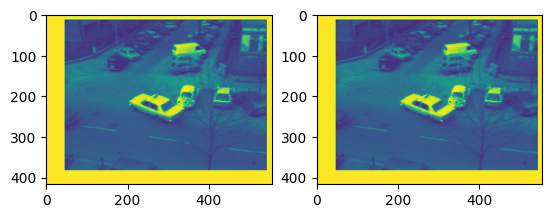

In [28]:
I1 = images['taxi_frame000.png']
I2 = images['taxi_frame001.png']
fig, ax = plt.subplots(1, 2)
ax[0].imshow(I1)
ax[1].imshow(I1)
plt.show()

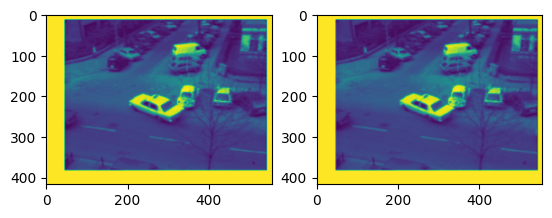

In [29]:
import cv2
I1 = np.array(I1)
I2 = np.array(I2)
# Сглаживаем изображения с помощью гауссовского фильтра
smoothed_I1 = cv2.GaussianBlur(I1, (5, 5), 0)
smoothed_I2 = cv2.GaussianBlur(I2, (5, 5), 0)
fig, ax = plt.subplots(1, 2)
ax[0].imshow(smoothed_I1)
ax[1].imshow(smoothed_I2)
plt.show()

In [30]:
# Определение ядер для градиентов X, Y
Gx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])  # Ядро Собеля для градиента по X
Gy = np.array([[-1, -2, -1], [ 0,  0,  0], [ 1,  2,  1]])  # Ядро Собеля для градиента по Y

In [31]:
# Ядро для среднего фильтра (temporal gradient)
Mt = np.ones((4, 4)) / 16
Mt

array([[0.0625, 0.0625, 0.0625, 0.0625],
       [0.0625, 0.0625, 0.0625, 0.0625],
       [0.0625, 0.0625, 0.0625, 0.0625],
       [0.0625, 0.0625, 0.0625, 0.0625]])

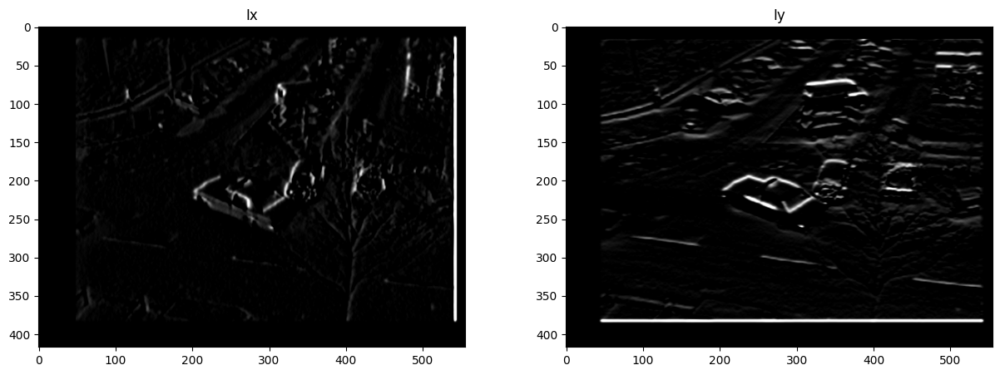

In [32]:
# Вычисление градиентов Ix, Iy используя свертку
Ix = cv2.filter2D(smoothed_I1, -1, Gx)  # Gx уже определено
Iy = cv2.filter2D(smoothed_I1, -1, Gy)

fig, ax = plt.subplots(1, 2, figsize=(15, 5))  # Устанавливаем размер фигуры

# Отображаем изображения на осях
ax[0].imshow(Ix, cmap='gray')
ax[1].imshow(Iy, cmap='gray')

# Добавляем подписи к осям
ax[0].set_title('Ix')
ax[1].set_title('Iy')

plt.show()


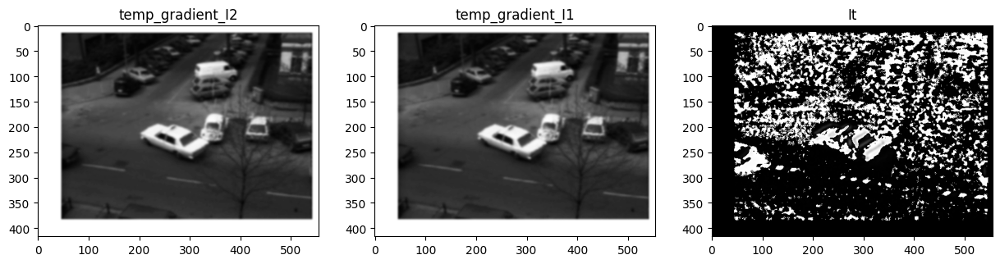

In [33]:
# Вычисление временного градиента It
temp_gradient_I2 = cv2.filter2D(smoothed_I2, -1, Mt)
temp_gradient_I1 = cv2.filter2D(smoothed_I1, -1, Mt)
It = temp_gradient_I2 - temp_gradient_I1

fig, ax = plt.subplots(1, 3, figsize=(15, 5))  # Устанавливаем размер фигуры

# Отображаем изображения на осях
ax[0].imshow(temp_gradient_I2, cmap='gray')
ax[1].imshow(temp_gradient_I1, cmap='gray')
ax[2].imshow(It, cmap='gray')

# Добавляем подписи к осям
ax[0].set_title('temp_gradient_I2')
ax[1].set_title('temp_gradient_I1')
ax[2].set_title('It')

plt.show()

#### Original from Teacher Code Implement and test step by step

##### Test Computing the gradients

In [34]:
kernel_x = np.array([[-1., 1.], [-1., 1.]])
kernel_x

array([[-1.,  1.],
       [-1.,  1.]])

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
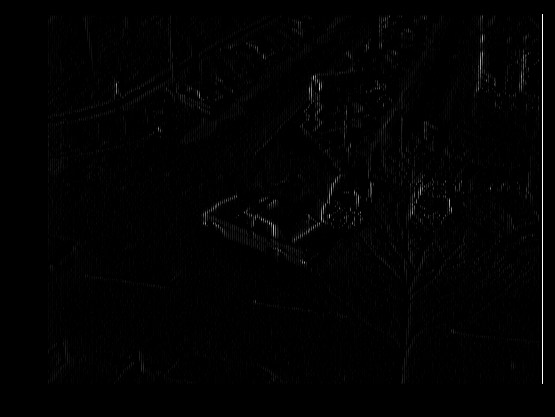

In [35]:
convolved_image_x = cv2.filter2D(I1, -1, kernel_x)
convolved_image_x

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
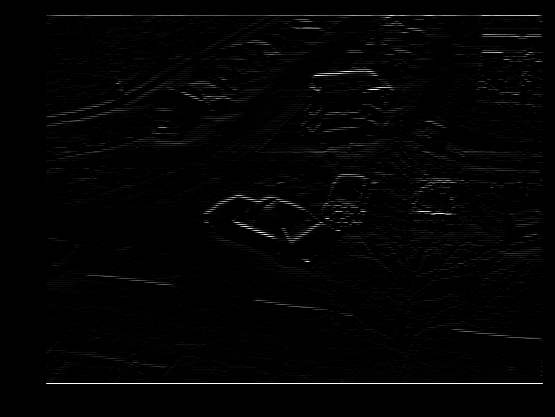

In [36]:
kernel_y = kernel_x.T
convolved_image_y = cv2.filter2D(I1, -1, kernel_y)
convolved_image_y

 Mt is the 4×4 mask for a mean filter

In [37]:
# Создание ядра среднего фильтра 4x4
kernel_size = 4
kernel_t = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size**2)
kernel_t

array([[0.0625, 0.0625, 0.0625, 0.0625],
       [0.0625, 0.0625, 0.0625, 0.0625],
       [0.0625, 0.0625, 0.0625, 0.0625],
       [0.0625, 0.0625, 0.0625, 0.0625]], dtype=float32)

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
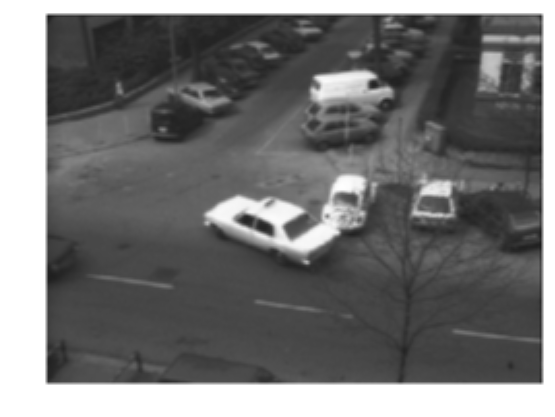

In [38]:
convolved_image_t1 = cv2.filter2D(I1, -1, kernel_t)
convolved_image_t1

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
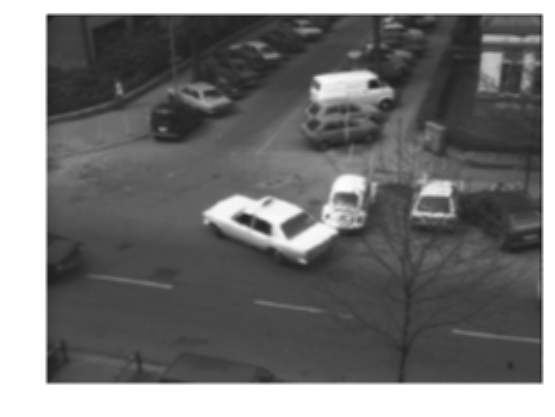

In [39]:
convolved_image_t2 = cv2.filter2D(I2, -1, kernel_t)
convolved_image_t2

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
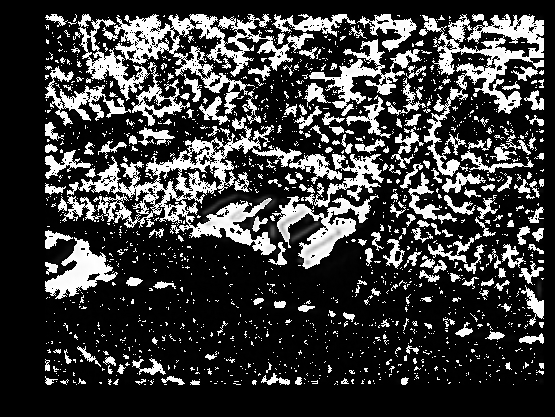

In [40]:
It = convolved_image_t2 - convolved_image_t1
It

With out core

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
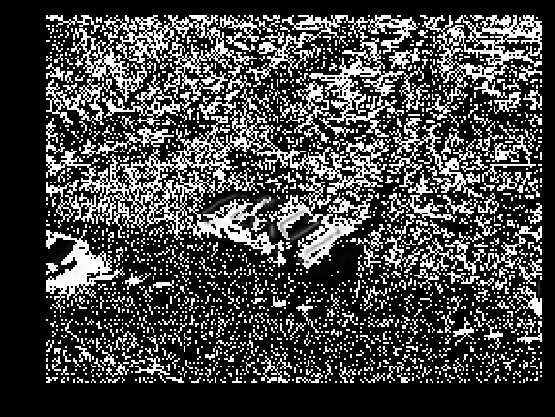

In [41]:
z = I2 - I1
z

##### Test Computing $A^TA$ and $A^Tb$

In [42]:
Ix = convolved_image_y.flatten()
Ix.shape

(231435,)

In [43]:
Iy = convolved_image_x.flatten()
Ix.shape

(231435,)

In [44]:
It = It.flatten()
It.shape

(231435,)

In [45]:
# Формирование матрицы A
A = np.vstack((Ix, Iy)) #Складывает по строчно
                        #np.column_stack() сразу в столбцы или 1,26 + np.stack((Ix, Iy), axis=-1)
A=A.T
A.shape

(231435, 2)

In [46]:
#и вектора b
b = -It.reshape(-1, 1)
b.shape

(231435, 1)

In [47]:
# Вычисление A^T A
AtA = np.dot(A.T, A)
AtA.shape

(2, 2)

In [48]:
# Вычисление A^T b
Atb = np.dot(A.T, b)
Atb.shape

(2, 1)

In [49]:
# Решение уравнения оптического потока
u = np.linalg.inv(AtA).dot(Atb)  #np.linalg.inv(A) - вернет обратную матрицу A^(-1).
                                 #np.linalg.inv(AtA) - вычисляет обратную матрицу от AtA
                                 #np.linalg.inv(AtA).dot(Atb) - это умножение обратной матрицы AtA на вектор Atb. Это дает решение уравнения u
u

array([[  7.01555556],
       [-11.08222222]])

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
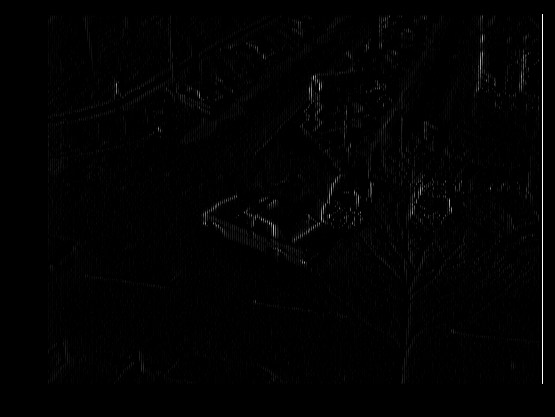

In [50]:
w = 1 // 2
k = convolved_image_x.shape[0] - w
k
k2 = convolved_image_x.shape[1] - w
k2
part_of_image = convolved_image_x[w:k, w:k2]
part_of_image

In [51]:
Ix = convolved_image_x[w:w+1, w:w+1].flatten() #область вокруг пикселя (i, j) с помощью срезов [i-w:i+w+1, j-w:j+w+1]
Ix

array([0], dtype=uint8)

##### Testing and Fine tune all Function

In [52]:
#------------Работает стандарт стоит в первой функции----------------

kernel_x = np.array([[-1., 1.], [-1., 1.]])

#Your code (1): kernels for y
kernel_y = kernel_x.T # Transpouse for Vertical

#Your code (1): kernels for t
kernel_size = 4
kernel_t = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size**2)

w = int(window_size/2) # window_size is odd, all the pixels with offset in between [-w, w] are inside the window

I1g = gaussian(I1, sigma=5, truncate=1/5)
I2g = gaussian(I2, sigma=5, truncate=1/5)

    # Implement Lucas-Kanade
    # for each image point, calculate I_x, I_y, I_t
mode = 'same'
fx = signal.convolve2d(I1g, kernel_x, boundary='symm', mode=mode)

 #fy = # your code (1)
fy = signal.convolve2d(I1g, kernel_y, boundary='symm', mode=mode)

 #ft = # your code (1)

ft1 = signal.convolve2d(I1g, kernel_t, boundary='symm', mode=mode)
ft2 = signal.convolve2d(I2g, kernel_t, boundary='symm', mode=mode)
ft = ft1 - ft2 # Если сделать так (есть буфер кадров )ft = ft2 - ft1 то b = It.reshape(-1, 1) можно не инвертировать b = - It.reshape(-1, 1)

In [53]:
#------------Рабоьать с этим---------------- Изменеия и ускорения которые перейдут во вторую ыункцию

kernel_x = np.array([[-1., 1.], [-1., 1.]])

#Your code (1): kernels for y
kernel_y = kernel_x.T # Transpouse for Vertical

#Your code (1): kernels for t
kernel_size = 4
kernel_t = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size**2)

#w = int(window_size/2) # window_size is odd, all the pixels with offset in between [-w, w] are inside the window

I1g = gaussian(I1, sigma=5, truncate=1/5)
I2g = gaussian(I2, sigma=5, truncate=1/5)

    # Implement Lucas-Kanade
    # for each image point, calculate I_x, I_y, I_t
mode = 'same'
fx = (signal.convolve2d(I2, kernel_x, boundary='symm', mode=mode) - signal.convolve2d(I1, kernel_x, boundary='symm', mode=mode))/4

 #fy = # your code (1)
fy = (signal.convolve2d(I2, kernel_y, boundary='symm', mode=mode) - signal.convolve2d(I1, kernel_y, boundary='symm', mode=mode))/4

 #ft = # your code (1)

ft1 = signal.convolve2d(I1g, kernel_t, boundary='symm', mode=mode)
ft2 = signal.convolve2d(I2g, kernel_t, boundary='symm', mode=mode)
ft = (ft2 - ft1)/4 # Если сделать так (есть буфер кадров )ft = ft2 - ft1 то b = It.reshape(-1, 1) можно не инвертировать b = - It.reshape(-1, 1)

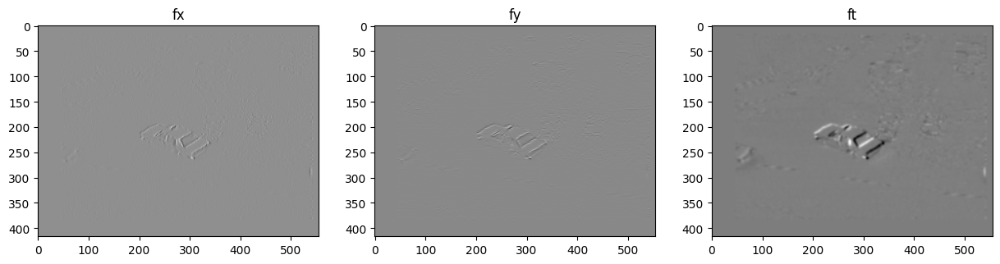

In [54]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))  # Устанавливаем размер фигуры

# Отображаем изображения на осях
ax[0].imshow(fx, cmap='gray')
ax[1].imshow(fy, cmap='gray')
ax[2].imshow(ft, cmap='gray')

# Добавляем подписи к осям
ax[0].set_title('fx')
ax[1].set_title('fy')
ax[2].set_title('ft')

plt.show()

###### Testing np Functions

In [55]:
ffx = fx.flatten()
ffy = fy.flatten()

In [56]:
zA = np.column_stack((ffx, ffy)) #Same that np.vstack + Transp of result
print(zA.shape)
#plt.imshow(zA, cmap='gray')

(231435, 2)


In [57]:
fft = ft.flatten()
print(fft.shape)

(231435,)


In [58]:
fft = ft.reshape((-1, 1))
print(fft.shape)

(231435, 1)


In [59]:
zAtA = np.dot(zA.T, A)
print(zAtA.shape)

(2, 2)


In [60]:
zAtb = np.dot(zA.T, fft)
print(zAtb.shape)

(2, 1)


###### Next Step cicle FOR

In [61]:
tau = 0.01
w = 3
u = np.zeros(I1g.shape)
v = np.zeros(I1g.shape)

# iterate for each image window of size window_size * window_size
M,N = I1g.shape
for i in range(w, M-w):
    for j in range(w, N-w): #Создаем массив части изображения
        Ix = fx[i-w:i+w+1, j-w:j+w+1].flatten() # fx нашли вертикаль через конв с ядром [-1., 1.], [-1., 1.] . Из этого изображения берем кусочки
        Iy = fy[i-w:i+w+1, j-w:j+w+1].flatten() # fy нашли горизонталь [-1., -1.], [1., 1.] . Из этого изображения берем кусочки
        It = ft[i-w:i+w+1, j-w:j+w+1].reshape((-1, 1)) # ft  вычли изображения из 2 - 1. Из этого изображения берем кусочки. Сразу делаем reshape

        #AtA = # your code (2)  #A = np.vstack((Ix, Iy)) -- A=A.T
        A = np.column_stack((Ix, Iy)) #Same that np.vstack + Transp of result
        AtA = np.dot(A.T, A)

        #Atb = # your code (2)
        #b = - It.reshape(-1, 1)   # В одинстолбец [Ix, Iy][u / V] = -It так как их тейлора вывели что все производные можно уюрать оставив только I(x,y,t)
                                # Если сделать так (есть буфер кадров )ft = ft2 - ft1 то b = It.reshape(-1, 1) можно не инвертировать b = - It.reshape(-1, 1)
        Atb = np.dot(A.T, It)

        if np.linalg.matrix_rank(AtA) == 2 and np.min(np.linalg.eigvals(AtA)) > tau:
           nu, residuals, rank, s = np.linalg.lstsq(AtA, Atb, rcond=None)   #Функция np.linalg.lstsq возвращает кортеж из четырех элементов:
                                                                              # x : решения уравнения;
                                                                              # residuals : суммы квадратов остатков;
                                                                              # rank : ранг матрицы данных;
                                                                              # s : сингулярные значения матрицы данных.
           u[i, j] = nu[0, 0]  # Извлекаем первый элемент из первой строки
           v[i, j] = nu[1, 0]  # Извлекаем второй элемент из первой строки, если он есть
           #print(f"Pixel position ({i},{j}):")
           #print(f"  Optical flow components - u: {u[i,j]}, v: {v[i,j]}")
           #print(f"  Least squares solution (nu): {nu.flatten()}")
           #print(f"  Residuals: {residuals}")
           #print(f"  Rank of the matrix: {rank}")
           #print(f"  Singular values: {s}")
        else:

            u[i, j] = 0
            v[i, j] = 0
            #print(f"Pixel position ({i},{j}): Poorly conditioned problem.")
print(I1g.shape)
print(M)
print(N)
print(u.shape)
print(v.shape)


(417, 555)
417
555
(417, 555)
(417, 555)


###### Print Results

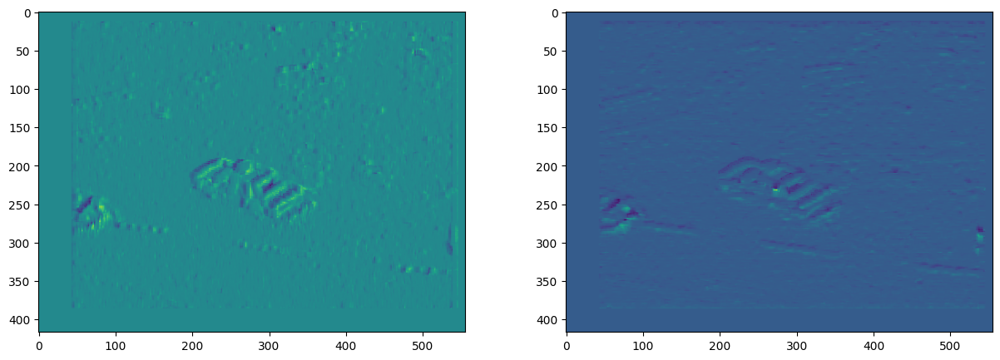

In [62]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].imshow(u)
ax[1].imshow(v)

In [63]:
# Нормализация векторов для лучшей визуализации
magnitude = np.sqrt(u**2 + v**2)
norm_u = u / (magnitude + 1e-5)  # Добавляем небольшую константу, чтобы избежать деления на ноль
norm_v = v / (magnitude + 1e-5)

In [64]:
# Нормализация векторов для лучшей визуализации
magnitude = np.sqrt(u**2 + v**2)
norm_u = u
norm_v = v

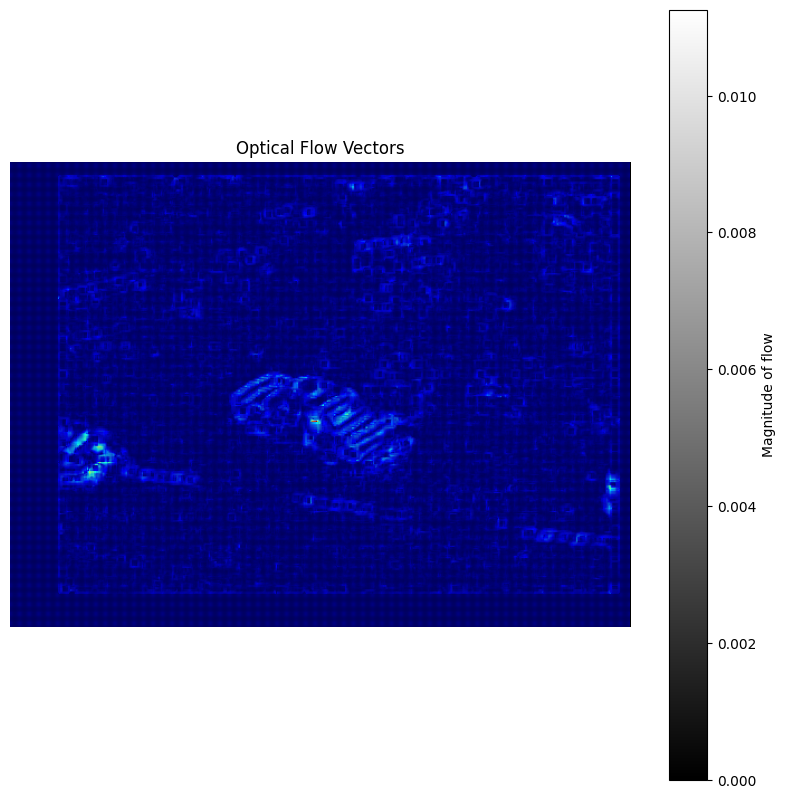

In [65]:
# Создание квивер-плота
plt.figure(figsize=(10, 10))
plt.quiver(norm_u, norm_v, magnitude, scale=50, cmap='jet')
plt.title('Optical Flow Vectors')
plt.axis('off')
plt.imshow(magnitude, cmap='gray', interpolation='nearest')
plt.colorbar(label='Magnitude of flow')
plt.show()

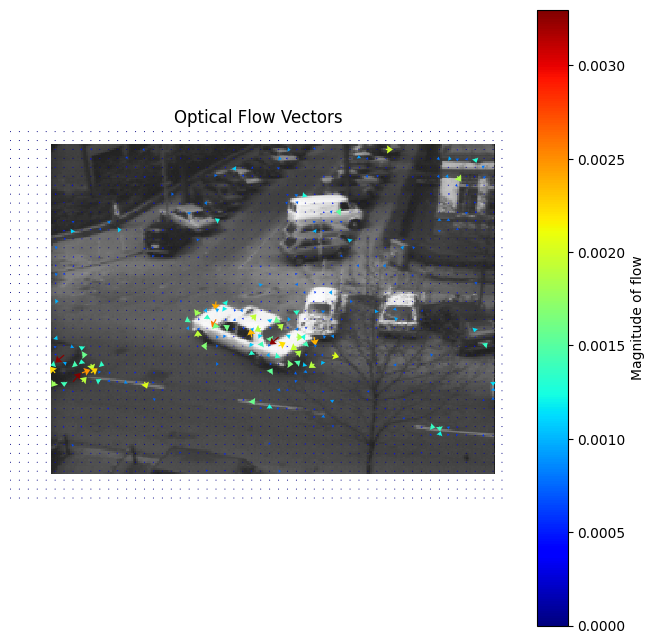

In [66]:
# Определяем шаг сетки для стрелок, чтобы график был читаемым
step = 10  # Шаг сетки; стрелки будут размещаться на каждом 10-м пикселе

# Создаем quiver plot
plt.figure(figsize=(8, 8))
plt.imshow(I2, cmap='gray', interpolation='nearest')
plt.quiver(np.arange(0, u.shape[1], step), np.arange(0, u.shape[0], step),
           ((norm_u[::step, ::step]) * 360), ((norm_v[::step, ::step]) * 360), (magnitude[::step, ::step]),
           scale=50, cmap='jet', headwidth=7)

plt.title('Optical Flow Vectors')
plt.axis('off')  # Отключаем оси
plt.colorbar(label='Magnitude of flow')
plt.show()

##### Exe Function optical_flow provide by Teacher

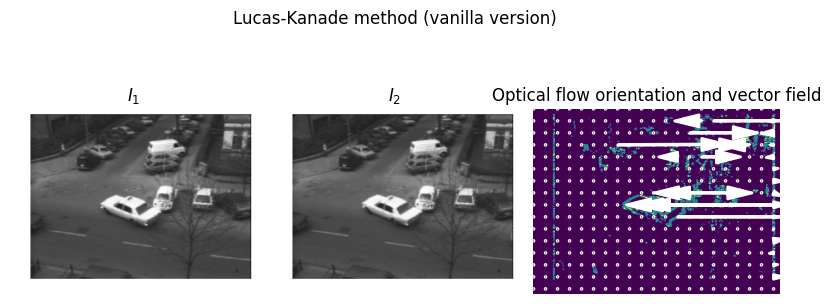

In [67]:
window_size = 3
tau = 0.01
# Running the LK method
#u, v = np.zeros_like(I1), np.zeros_like(I1) # comment out this line with the proper call (below) when you are ready
u,v = optical_flow(I1, I2, window_size=window_size, tau=tau)
display_optic_flow(I1, I2, -u, -v, "Lucas-Kanade method (vanilla version)")


##### Def my Function optical_flow_2

###### Def my Function optical_flow1 BAD Result

In [68]:
def optical_flow1(I1, I2, window_size=3):
   "Faster And Shoter"

   # Вычисление градиентов
   kernel_x = np.array([[-1, 1], [-1, 1]])# * 0.25  # ядро для градиента по x
   kernel_y = np.array([[-1, -1], [1, 1]])# * 0.25  # ядро для градиента по y
   kernel_t = np.ones((4, 4)) * 0.0625#* 0.25  # ядро для временного градиента

   Ix = cv2.filter2D(I1, -1, kernel_x) + cv2.filter2D(I2, -1, kernel_x)
   Iy = cv2.filter2D(I1, -1, kernel_y) + cv2.filter2D(I2, -1, kernel_y)
   It = cv2.filter2D(I2, -1, kernel_t) - cv2.filter2D(I1, -1, kernel_t)


   # Параметры для оптического потока
   u = np.zeros(I1.shape)
   v = np.zeros(I1.shape)

       # Размер окна
   w = window_size // 2

   # iterate for each image window of size window_size * window_size
   for y in range(w, I1.shape[0] - w):
       for x in range(w, I1.shape[1] - w):
           # Выделение окна для каждого компонента
           Ix_win = Ix[y-w:y+w+1, x-w:x+w+1].flatten()
           Iy_win = Iy[y-w:y+w+1, x-w:x+w+1].flatten()
           It_win = It[y-w:y+w+1, x-w:x+w+1].flatten()

           # Формирование матрицы A и вектора b
           A = np.vstack((Ix_win, Iy_win)).T
           b = -It_win

#           AtA = np.dot(A.T, A)
#           Atb = np.dot(A.T, b)

           # Решение системы уравнений
           nu = np.linalg.lstsq(A, b, rcond=None)[0]
           u[y, x] = nu[0]
           v[y, x] = nu[1]

   return u, v

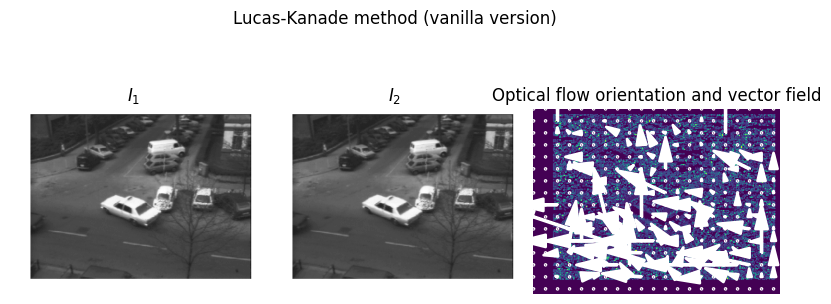

In [69]:
window_size = 3
tau = 0.01
# Running the LK method
#u, v = np.zeros_like(I1), np.zeros_like(I1) # comment out this line with the proper call (below) when you are ready
u,v = optical_flow1(I1, I2, window_size=window_size)
display_optic_flow(I1, I2, -u, -v, "Lucas-Kanade method (vanilla version)")


###### Def my Function optical_flow2 Testing New Var

In [70]:
kernel_x = np.array([[-1., 1.], [-1., 1.]])
kernel_y = kernel_x.T # Transpouse for Vertical
kernel_t = np.ones((4, 4)) * 0.0625#* 0.25  # ядро для временного градиента

I1g = gaussian(I1, sigma=5, truncate=1/5)
I2g = gaussian(I2, sigma=5, truncate=1/5)

mode = 'same'
fx = signal.convolve2d(I1, kernel_x, boundary='symm', mode=mode) + signal.convolve2d(I2, kernel_x, boundary='symm', mode=mode)


fy = signal.convolve2d(I1, kernel_y, boundary='symm', mode=mode) + signal.convolve2d(I2, kernel_y, boundary='symm', mode=mode)


ft1 = signal.convolve2d(I1g, kernel_t, boundary='symm', mode=mode)
ft2 = signal.convolve2d(I2g, kernel_t, boundary='symm', mode=mode)
ft = ft2 - ft1 # Если сделать так (есть буфер кадров )ft = ft2 - ft1 то b = It.reshape(-1, 1) можно не инвертировать b = - It.reshape(-1, 1)



tau = 0.01
w = 6 # More Data bigger window
u = np.zeros(I1.shape)
v = np.zeros(I1.shape)

# iterate for each image window of size window_size * window_size
M,N = I1.shape
for i in range(w, M-w):
    for j in range(w, N-w): #Создаем массив части изображения
        Ix = fx[i-w:i+w+1, j-w:j+w+1].flatten() # fx нашли вертикаль через конв с ядром [-1., 1.], [-1., 1.]
        Iy = fy[i-w:i+w+1, j-w:j+w+1].flatten() # fy нашли горизонталь [-1., -1.], [1., 1.]
        It = ft[i-w:i+w+1, j-w:j+w+1].reshape((-1, 1)) # ft  вычли изображения из 2 - 1. Из этого изображения берем кусочки. Сразу делаем reshape

        A = np.column_stack((Ix, Iy)) #Same that np.vstack + Transp of result
        AtA = np.dot(A.T, A)

        Atb = np.dot(A.T, It)


        #if np.linalg.matrix_rank(AtA) == 2 and np.min(np.linalg.eigvals(AtA)) > tau:
        #   nu, residuals, rank, s = np.linalg.lstsq(AtA, Atb, rcond=None)

        # -----------  Change it to simpler  All this np.linalg.matrix_rank(AtA) == 2 and np.min(np.linalg.eigvals(AtA)) change to np.linalg.inv no SVD

        try:  # мы предполагаем, что матрица невырождена и обратима.
           nu, residuals, rank, s = np.linalg.lstsq(AtA, Atb, rcond=None)
           u[i, j] = nu[0, 0]  # Извлекаем первый элемент из первой строки
           v[i, j] = nu[1, 0]  # Извлекаем второй элемент из первой строки, если он есть

        except np.linalg.LinAlgError:

            u[i, j] = 0
            v[i, j] = 0

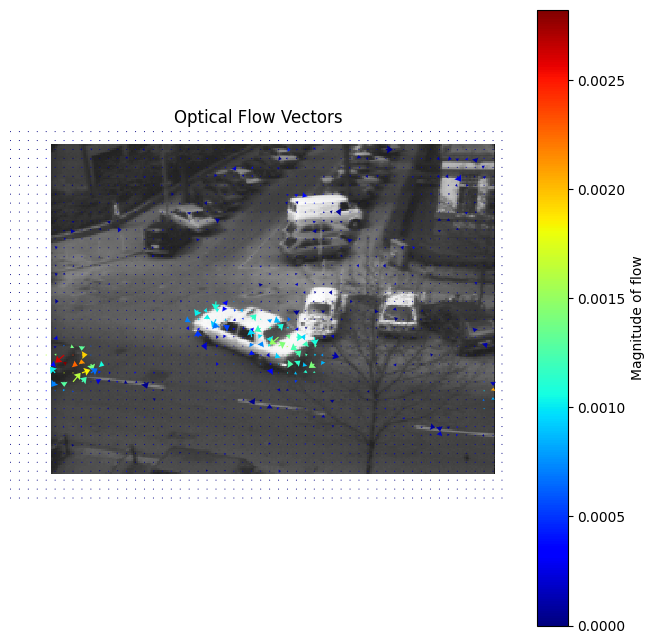

In [71]:
# Определяем шаг сетки для стрелок, чтобы график был читаемым
step = 10  # Шаг сетки; стрелки будут размещаться на каждом 10-м пикселе

#magnitude = np.log(np.sqrt(u**2 + v**2))
magnitude = np.sqrt(u**2 + v**2)
# Создаем quiver plot
plt.figure(figsize=(8, 8))
plt.imshow(I1, cmap='gray', interpolation='nearest')
plt.quiver(np.arange(0, u.shape[1], step), np.arange(0, u.shape[0], step),
          ((norm_u[::step, ::step]) * 360), ((norm_v[::step, ::step]) * 360), (magnitude[::step, ::step]),
          #np.log(u+1)[::step, ::step], np.log(v+1)[::step, ::step], magnitude[::step, ::step],
           scale=50, cmap='jet', headwidth=7)

plt.title('Optical Flow Vectors')
plt.axis('off')  # Отключаем оси
plt.colorbar(label='Magnitude of flow')
plt.show()

In [72]:
def optical_flow2(I1, I2, window_size=3):
    "Faster And Shoter"

    kernel_x = np.array([[-1., 1.], [-1., 1.]])
    kernel_y = kernel_x.T  # Transpose for Vertical
    kernel_t = np.ones((4, 4)) * 0.0625#* 0.25  # ядро для временного градиента

    #I1g = gaussian(I1, sigma=5, truncate=1/5)
    #I2g = gaussian(I2, sigma=5, truncate=1/5)

    mode = 'same'
    fx = signal.convolve2d(I1, kernel_x, boundary='symm', mode=mode)# - signal.convolve2d(I1, kernel_x, boundary='symm', mode=mode)#/4
    fy = signal.convolve2d(I1, kernel_y, boundary='symm', mode=mode)# - signal.convolve2d(I1, kernel_y, boundary='symm', mode=mode)#/4
    ft = signal.convolve2d(I2, kernel_t, boundary='symm', mode=mode) - signal.convolve2d(I1, kernel_t, boundary='symm', mode=mode)#/4
    # Если сделать так (есть буфер кадров) ft = ft2 - ft1, то b = It.reshape(-1, 1) можно не инвертировать b = - It.reshape(-1, 1)

    u = np.zeros(I1.shape)
    v = np.zeros(I1.shape)

     #Размер окна
    w = window_size // 2

    # iterate for each image window of size window_size * window_size
    M, N = I1.shape
    for i in range(w, M-w):
        for j in range(w, N-w):  # Создаем массив части изображения
            Ix = fx[i-w:i+w+1, j-w:j+w+1].flatten()  # fx нашли вертикаль через конв с ядром [-1., 1.], [-1., 1.]
            Iy = fy[i-w:i+w+1, j-w:j+w+1].flatten()  # fy нашли горизонталь [-1., -1.], [1., 1.]
            It = ft[i-w:i+w+1, j-w:j+w+1].reshape((-1, 1))  # ft  вычли изображения из 2 - 1. Из этого изображения берем кусочки. Сразу делаем reshape

            A = np.column_stack((Ix, Iy))  # Same that np.vstack + Transpose of result
            AtA = np.dot(A.T, A)
            Atb = np.dot(A.T, It)

            try:  # Мы предполагаем, что матрица невырождена и обратима.
                nu, residuals, rank, s = np.linalg.lstsq(AtA, Atb, rcond=None)
                u[i, j] = nu[0, 0]  # Извлекаем первый элемент из первой строки
                v[i, j] = nu[1, 0]  # Извлекаем второй элемент из первой строки, если он есть
            except np.linalg.LinAlgError:
                u[i, j] = 0
                v[i, j] = 0

    return u, v


###### Def my Plot Function

In [73]:
def display_quiver_plot(I1, u, v, step=10, title='Optical Flow Vectors'):
    """
    Displays a quiver plot for the optical flow vectors on top of the image.

    Parameters:
        I1 (numpy.ndarray): The first image frame (grayscale).
        u (numpy.ndarray): The horizontal components of the optical flow vectors.
        v (numpy.ndarray): The vertical components of the optical flow vectors.
        step (int): The grid step size for displaying vectors (default: 10 pixels).
        title (str): The title of the plot.
    """
    # Normalize the flow vectors for better visualization
    magnitude = np.sqrt(u**2 + v**2)
    #norm_u = u / (magnitude + 1e-5)  # Adding a small constant to avoid division by zero
    #norm_v = v / (magnitude + 1e-5)

    norm_u = u
    norm_v = v

    # Set up the quiver plot
    plt.figure(figsize=(8, 8))
    plt.imshow(I1, cmap='gray', interpolation='nearest')
    plt.quiver(np.arange(0, u.shape[1], step), np.arange(0, u.shape[0], step),
               norm_u[::step, ::step], norm_v[::step, ::step], magnitude[::step, ::step],
               scale=50, cmap='jet', headwidth=7)

    plt.title(title)
    plt.axis('off')  # Turn off axis
    plt.colorbar(label='Magnitude of flow')
    plt.show()

# Example usage:
# Assuming `I1`, `u`, and `v` are defined as numpy arrays appropriately
# display_quiver_plot(I1, u, v)

In [74]:
def display_quiver_plotV2(I1, u, v, step=10, title='Optical Flow Vectors'):
    """
    Displays a quiver plot for the optical flow vectors on top of the image.

    Parameters:
        I1 (numpy.ndarray): The first image frame (grayscale).
        u (numpy.ndarray): The horizontal components of the optical flow vectors.
        v (numpy.ndarray): The vertical components of the optical flow vectors.
        step (int): The grid step size for displaying vectors (default: 10 pixels).
        title (str): The title of the plot.
    """
    # Normalize the flow vectors for better visualization

    magnitude = np.sqrt(u**2 + v**2)
    #norm_u = u / np.maximum(magnitude + 1e-5)#, 0.00001)  # Adding a small constant to avoid division by zero
    #norm_v = v / np.maximum(magnitude + 1e-5)#, 0.00001)

    #max_abs_u = np.max(np.abs(u))
    #max_abs_v = np.max(np.abs(v))

    #mean_abs_u = np.mean(np.abs(u))
    #mean_abs_v = np.mean(np.abs(v))

    #norm_u = u / (mean_abs_u*10)
    #norm_v = v / (mean_abs_u*10)

    #magnitude =((np.sqrt(u**2 + v**2)))
    #fg = np.min(u)
    #hj = np.min(v)
    #norm_u = u - fg
    #norm_v = v - hj

    norm_u = u
    norm_v = v

    # Set up the quiver plot
    plt.figure(figsize=(8, 8))
    plt.imshow(I1, cmap='gray', interpolation='nearest')
    plt.quiver(np.arange(0, u.shape[1], step), np.arange(0, u.shape[0], step),
               ((norm_u[::step, ::step]) * 3), ((norm_v[::step, ::step]) * 3), (magnitude[::step, ::step]),
               #norm_u[::step, ::step], norm_v[::step, ::step], magnitude[::step, ::step],
               scale=50, cmap='jet', headwidth=7)

    plt.title(title)
    plt.axis('off')  # Turn off axis
    plt.colorbar(label='Magnitude of flow')
    plt.show()

# Example usage:
# Assuming `I1`, `u`, and `v` are defined as numpy arrays appropriately
# display_quiver_plot(I1, u, v)

###### Plot test Result with New Plot Function

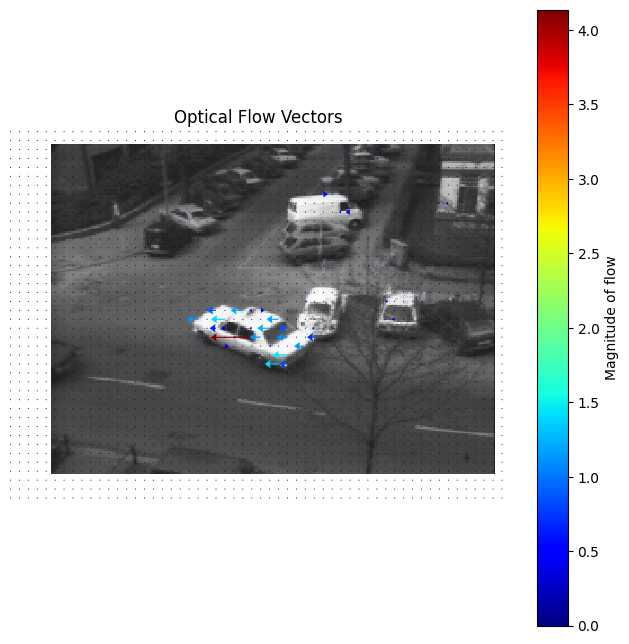

In [75]:
u,v = optical_flow(I1, I2, window_size=3, tau=tau)
display_quiver_plot(I1, u, v)

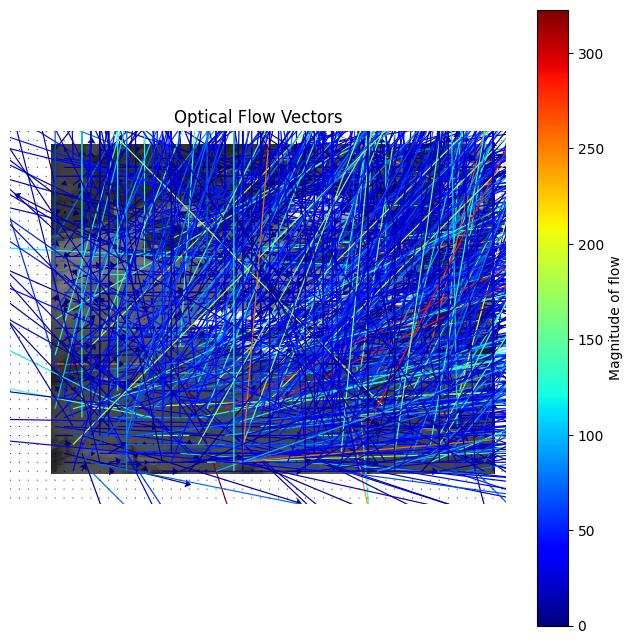

In [76]:
u,v = optical_flow1(I1, I2, window_size=3)
display_quiver_plotV2(I1, u, v)

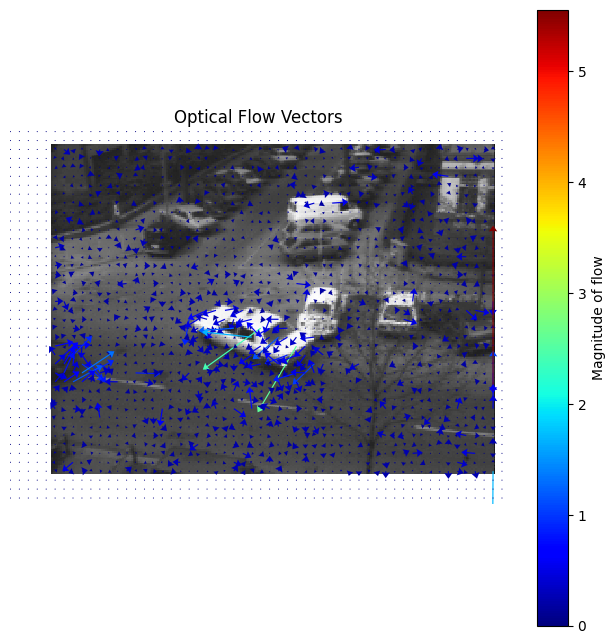

In [77]:
u,v = optical_flow2(I1, I2, window_size=5)
display_quiver_plotV2(I1, u, v)

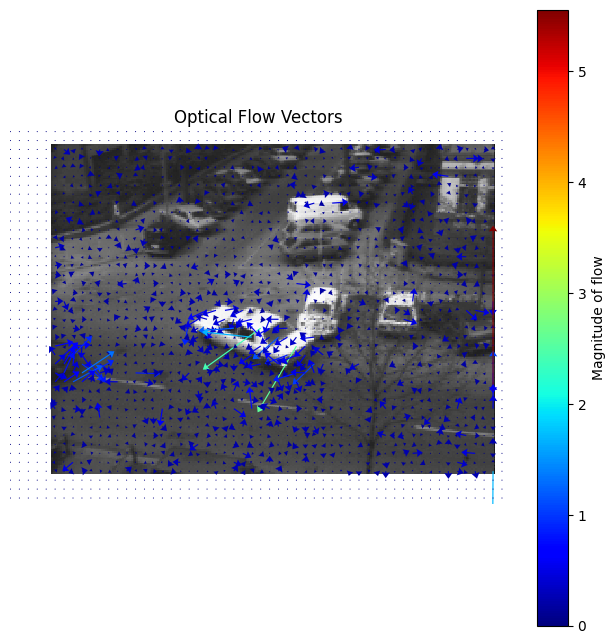

In [78]:
display_quiver_plotV2(I1, u, v)

###### Time Test

In [79]:
import time

# optical_flow и optical_flow1 уже импортированы и готовы к использованию
# Также предполагаем, что I1 и I2 - это изображения, загруженные и подготовленные для анализа

# Начало замера времени для первой функции
start_time = time.time()
u, v = optical_flow(I1, I2, window_size=3, tau=tau)
end_time = time.time()
time_optical_flow = end_time - start_time

# Вывод времени выполнения первой функции
print("Time taken by optical_flow: {:.4f} seconds".format(time_optical_flow))

# Начало замера времени для второй функции
start_time = time.time()
u1, v1 = optical_flow1(I1, I2, window_size=3)
end_time = time.time()
time_optical_flow1 = end_time - start_time

# Вывод времени выполнения второй функции
print("Time taken by optical_flow1: {:.4f} seconds".format(time_optical_flow1))

# Начало замера времени для второй функции
start_time = time.time()
u1, v1 = optical_flow2(I1, I2, window_size=3)
end_time = time.time()
time_optical_flow2 = end_time - start_time

# Вывод времени выполнения второй функции
print("Time taken by optical_flow2: {:.4f} seconds".format(time_optical_flow2))


Time taken by optical_flow: 22.4359 seconds
Time taken by optical_flow1: 9.5397 seconds
Time taken by optical_flow2: 9.8642 seconds


###### Full Run on All Set

In [80]:
folder_path = "./Lab6/imgs-P6/taxi/"


From Lub Work Teacher Function

In [81]:
def process_images_from_folder_Te(folder_path, window_size=10, tau=0.01):
    files = [os.path.join(folder_path, f) for f in sorted(os.listdir(folder_path)) if f.endswith('.png')]
    flow_statistics = []  # Список для сохранения статистики по каждой паре изображений

    for i in range(len(files) - 1):
        I1 = cv2.imread(files[i], cv2.IMREAD_GRAYSCALE)
        I2 = cv2.imread(files[i+1], cv2.IMREAD_GRAYSCALE)
        if I1 is not None and I2 is not None:
            u, v = optical_flow(I1, I2, window_size,tau)
            display_quiver_plot(I1, u, v, step=20, title=f'Optical Flow between {os.path.basename(files[i])} and {os.path.basename(files[i+1])}')

            # Сбор статистики
            magnitude = np.sqrt(u**2 + v**2)
            max_magnitude = np.max(magnitude)
            min_magnitude = np.min(magnitude)
            mean_magnitude = np.mean(magnitude)
            std_magnitude = np.std(magnitude)

            # Сохранение статистики
            flow_statistics.append((max_magnitude, min_magnitude, mean_magnitude, std_magnitude))

    # Вывод статистики после обработки всех пар
    for index, stats in enumerate(flow_statistics):
        print(f"Stats for Image Pair {index + 1}: Max={stats[0]:.2f}, Min={stats[1]:.2f}, Mean={stats[2]:.2f}, Std Dev={stats[3]:.2f}")




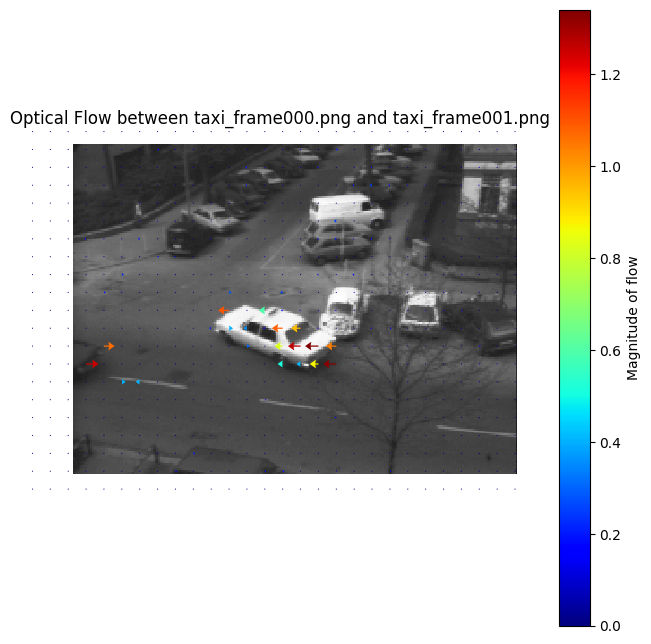

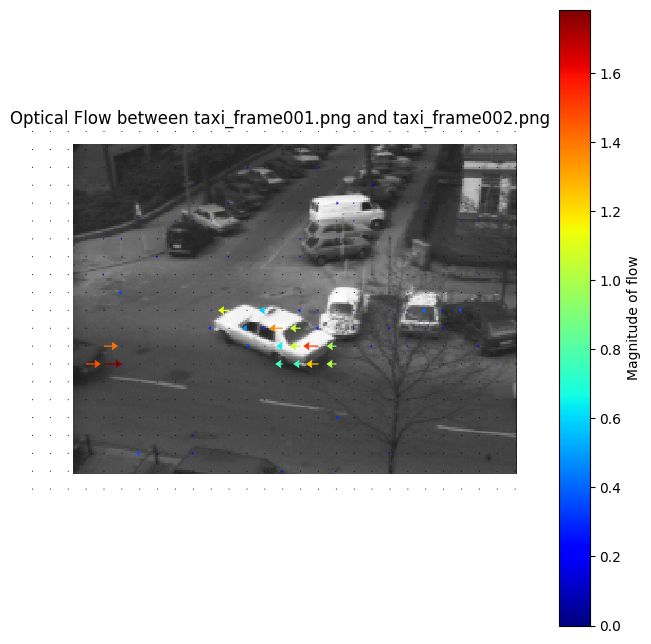

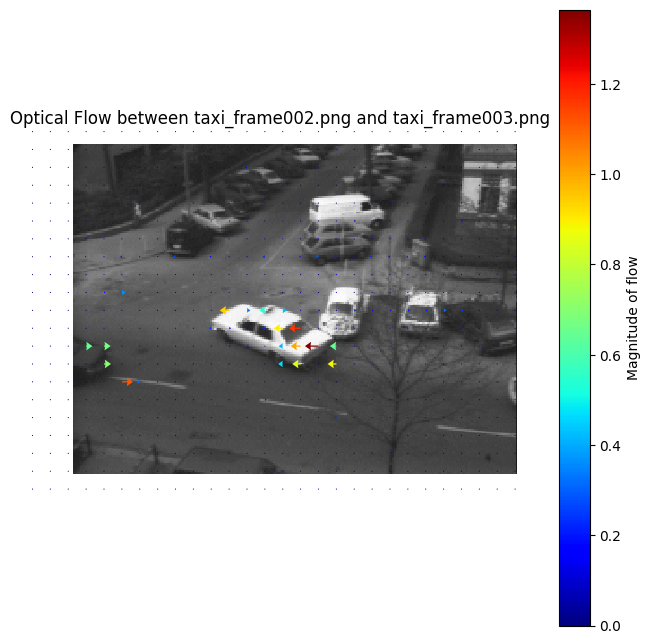

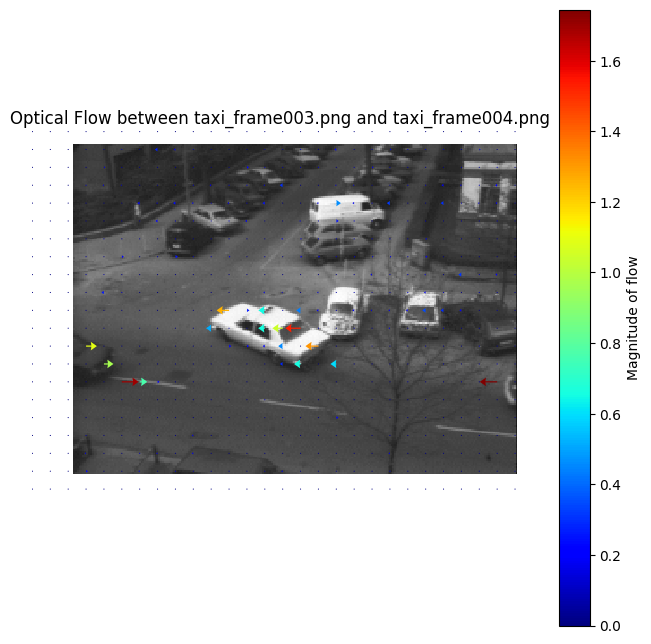

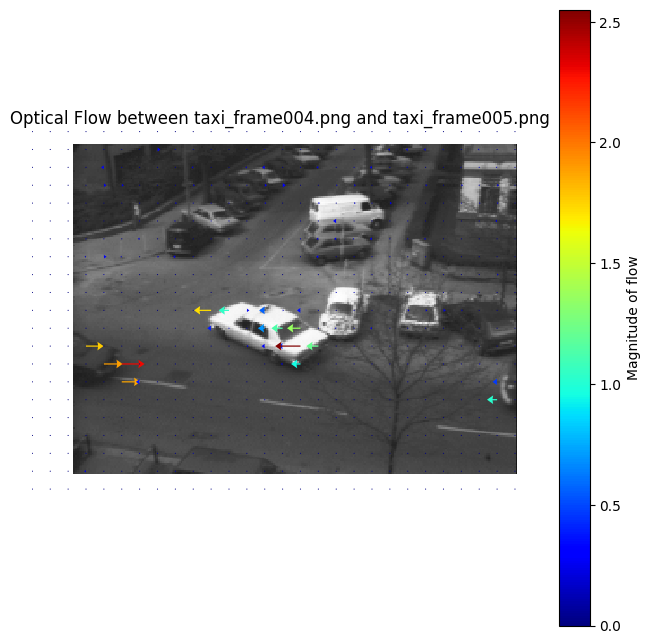

...

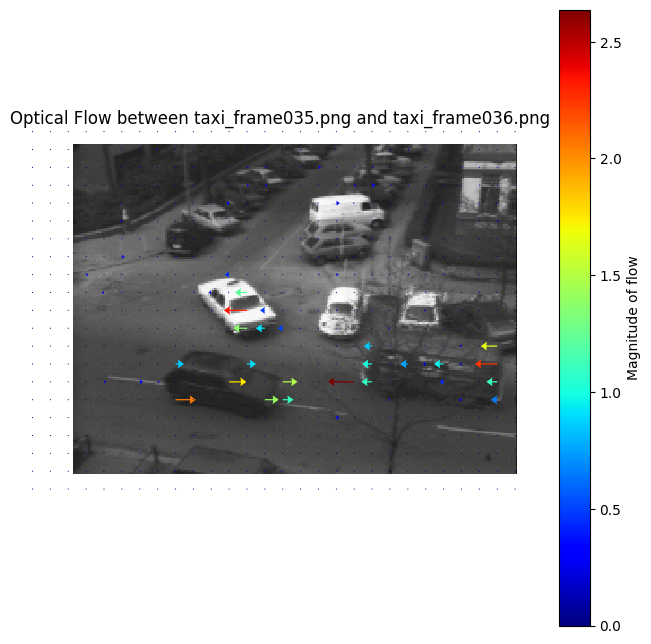

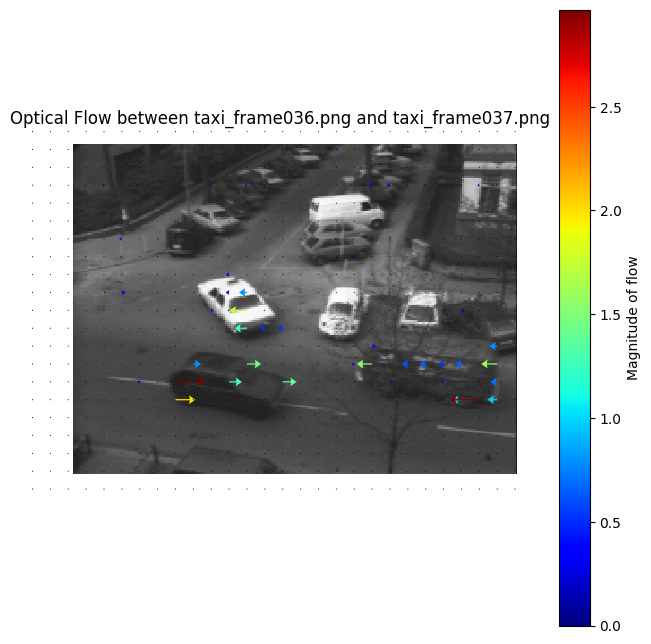

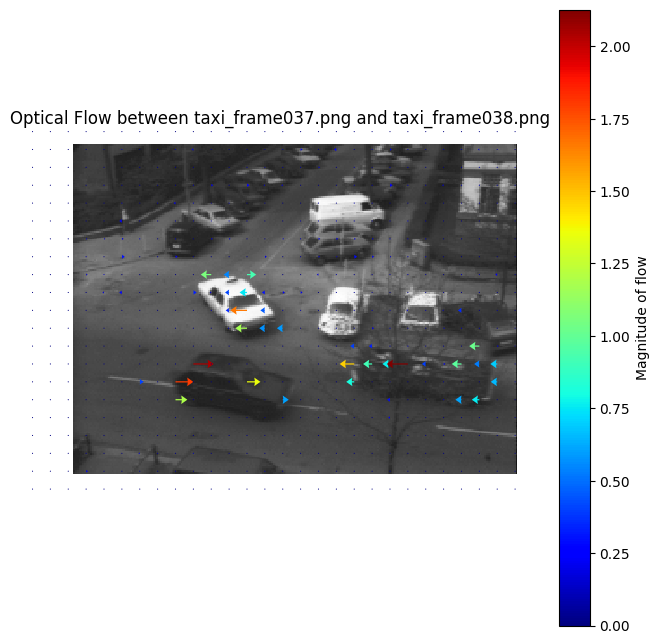

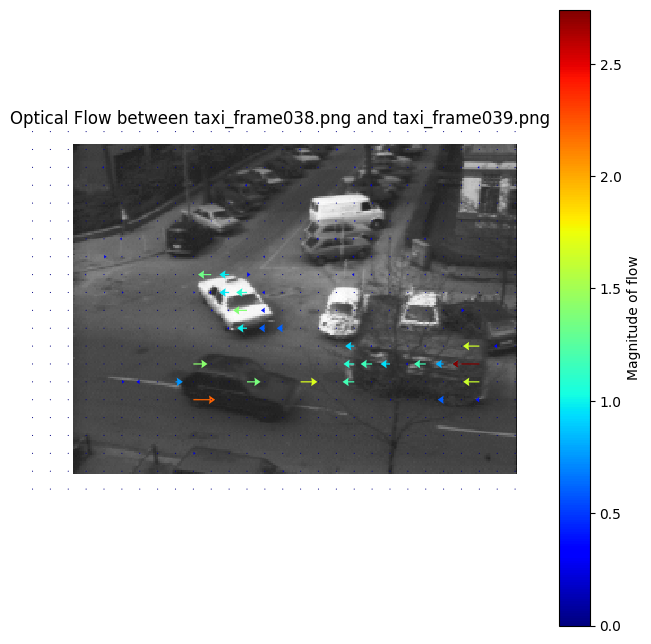

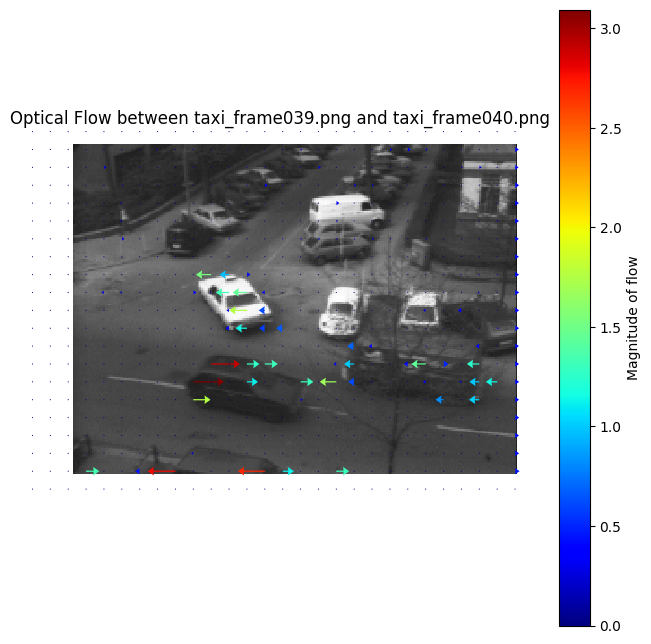

Stats for Image Pair 1: Max=4.30, Min=0.00, Mean=0.06, Std Dev=0.18
Stats for Image Pair 2: Max=4.80, Min=0.00, Mean=0.07, Std Dev=0.20
Stats for Image Pair 3: Max=4.49, Min=0.00, Mean=0.07, Std Dev=0.19
Stats for Image Pair 4: Max=4.46, Min=0.00, Mean=0.07, Std Dev=0.21
Stats for Image Pair 5: Max=3.95, Min=0.00, Mean=0.07, Std Dev=0.20
Stats for Image Pair 6: Max=5.47, Min=0.00, Mean=0.08, Std Dev=0.23
Stats for Image Pair 7: Max=5.26, Min=0.00, Mean=0.07, Std Dev=0.21
Stats for Image Pair 8: Max=3.82, Min=0.00, Mean=0.08, Std Dev=0.23
Stats for Image Pair 9: Max=3.64, Min=0.00, Mean=0.07, Std Dev=0.23
Stats for Image Pair 10: Max=3.75, Min=0.00, Mean=0.08, Std Dev=0.23
Stats for Image Pair 11: Max=3.89, Min=0.00, Mean=0.08, Std Dev=0.22
Stats for Image Pair 12: Max=4.33, Min=0.00, Mean=0.09, Std Dev=0.23
Stats for Image Pair 13: Max=4.05, Min=0.00, Mean=0.08, Std Dev=0.22
Stats for Image Pair 14: Max=4.04, Min=0.00, Mean=0.09, Std Dev=0.24
Stats for Image Pair 15: Max=3.96, Min=0.00

In [82]:
start_time = time.time()
# Вызов функции
process_images_from_folder_Te(folder_path)
end_time = time.time()
time_optical_flow = end_time - start_time

# Вывод времени выполнения первой функции
print("Time taken by optical_flow: {:.4f} seconds".format(time_optical_flow))

My Var 2

In [83]:
def process_images_from_folder_My(folder_path, window_size=10, tau=0.01):
    files = [os.path.join(folder_path, f) for f in sorted(os.listdir(folder_path)) if f.endswith('.png')]
    flow_statistics = []  # Список для сохранения статистики по каждой паре изображений

    for i in range(len(files) - 1):
        I1 = cv2.imread(files[i], cv2.IMREAD_GRAYSCALE)
        I2 = cv2.imread(files[i+1], cv2.IMREAD_GRAYSCALE)
        if I1 is not None and I2 is not None:
            u, v = optical_flow2(I1, I2, window_size)
            display_quiver_plotV2(I1, u, v, step=20, title=f'Optical Flow between {os.path.basename(files[i])} and {os.path.basename(files[i+1])}')

            # Сбор статистики
            magnitude = np.sqrt(u**2 + v**2)
            max_magnitude = np.max(magnitude)
            min_magnitude = np.min(magnitude)
            mean_magnitude = np.mean(magnitude)
            std_magnitude = np.std(magnitude)

            # Сохранение статистики
            flow_statistics.append((max_magnitude, min_magnitude, mean_magnitude, std_magnitude))

    # Вывод статистики после обработки всех пар
    for index, stats in enumerate(flow_statistics):
        print(f"Stats for Image Pair {index + 1}: Max={stats[0]:.2f}, Min={stats[1]:.2f}, Mean={stats[2]:.2f}, Std Dev={stats[3]:.2f}")


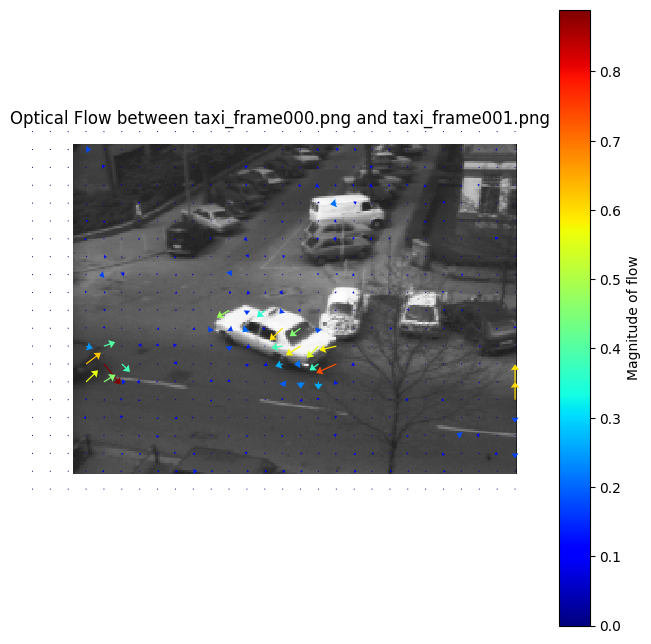

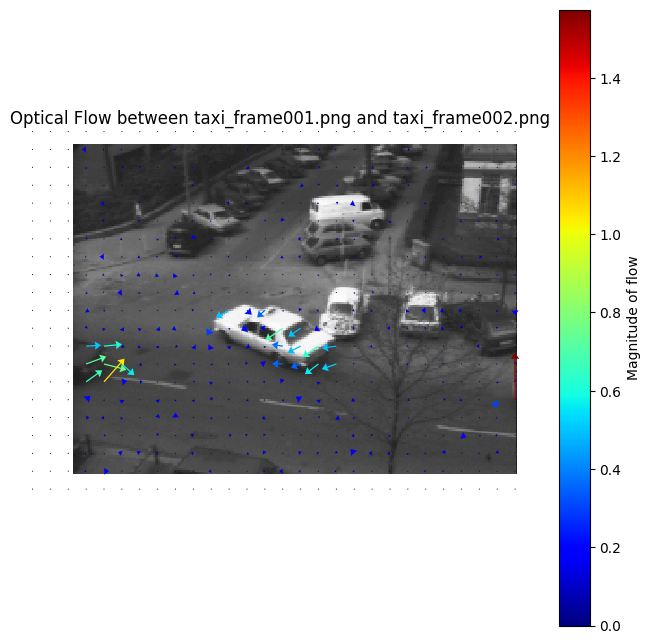

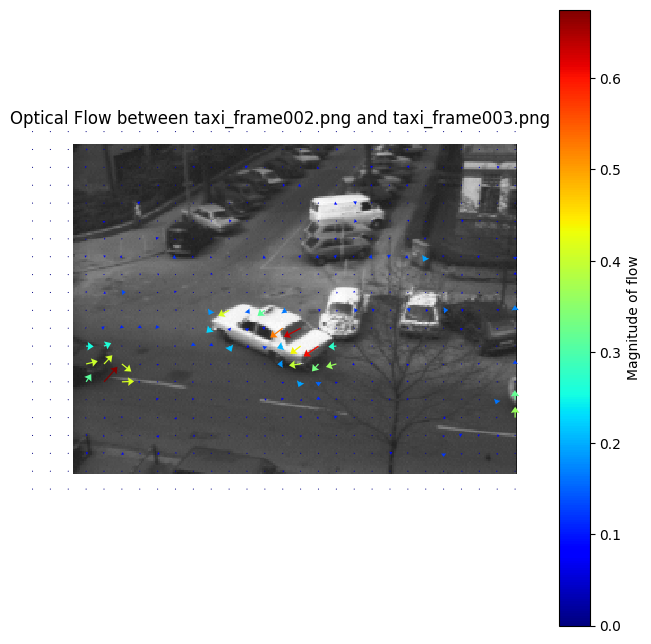

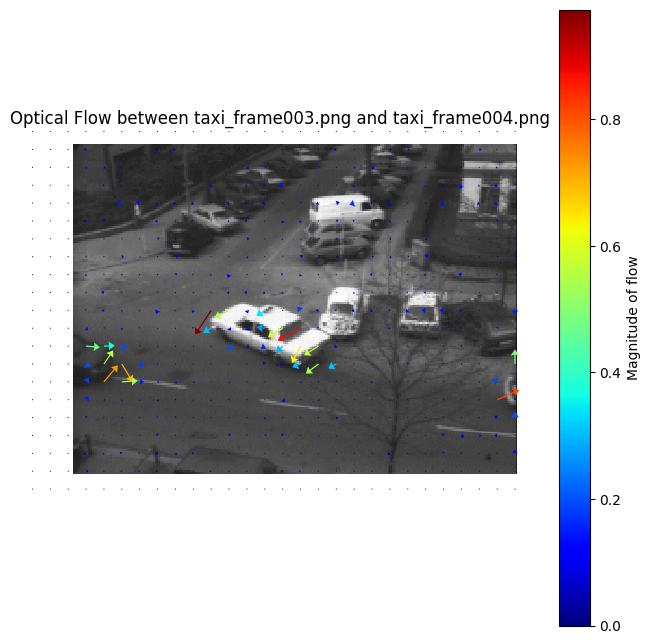

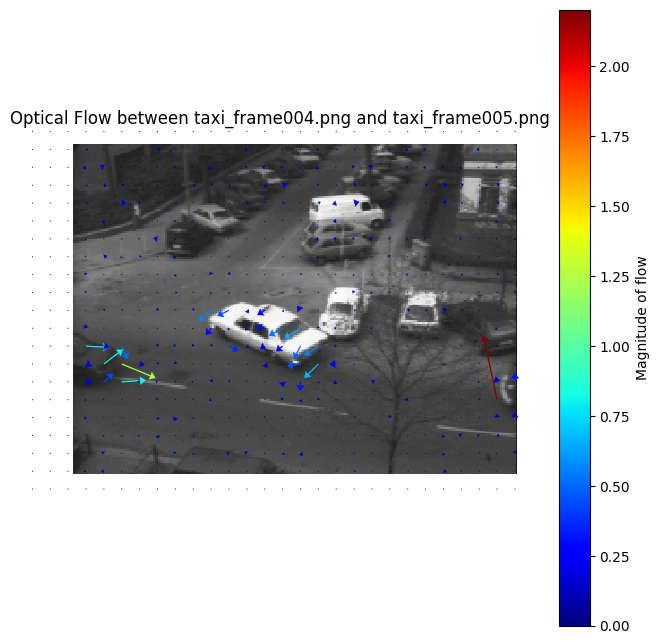

...

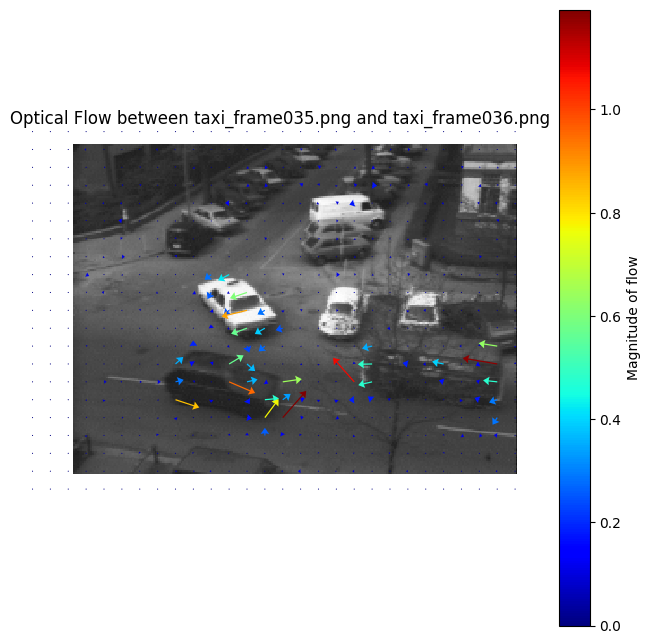

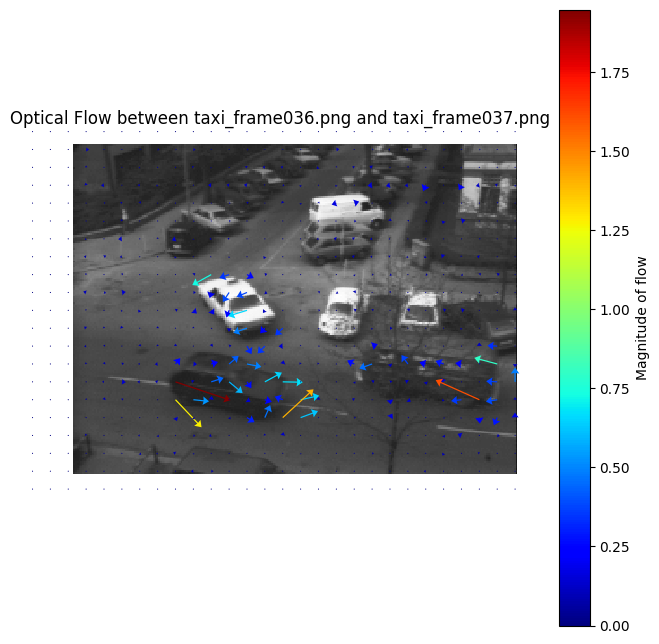

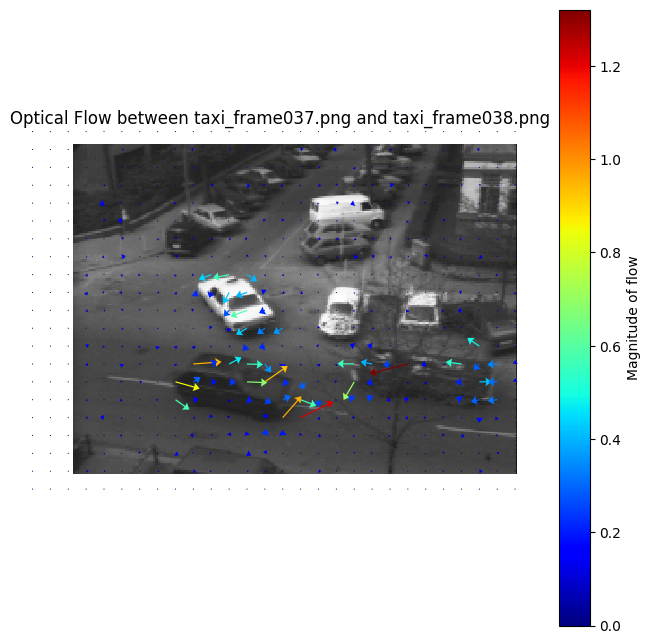

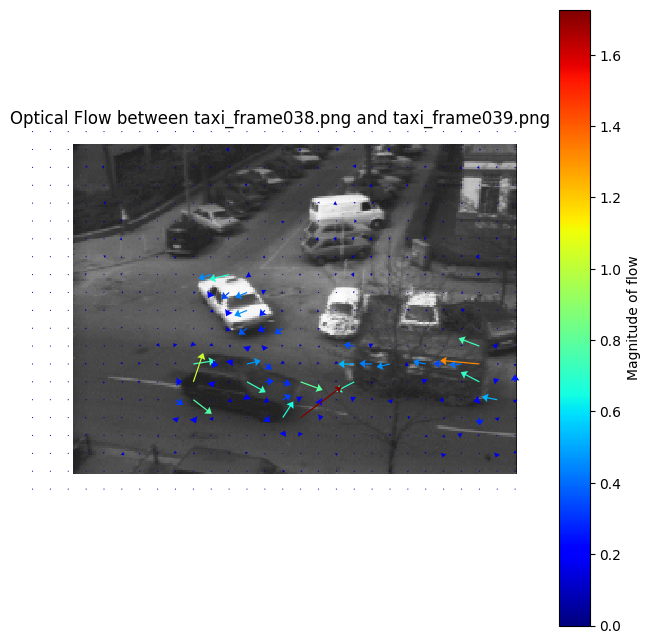

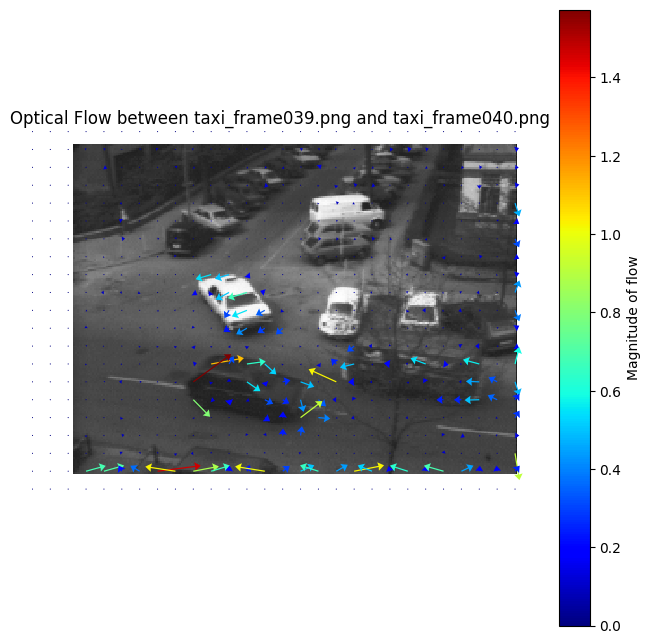

Stats for Image Pair 1: Max=5.91, Min=0.00, Mean=0.06, Std Dev=0.12
Stats for Image Pair 2: Max=3.59, Min=0.00, Mean=0.07, Std Dev=0.12
Stats for Image Pair 3: Max=3.32, Min=0.00, Mean=0.06, Std Dev=0.11
Stats for Image Pair 4: Max=2.08, Min=0.00, Mean=0.06, Std Dev=0.11
Stats for Image Pair 5: Max=3.69, Min=0.00, Mean=0.07, Std Dev=0.12
Stats for Image Pair 6: Max=3.63, Min=0.00, Mean=0.08, Std Dev=0.13
Stats for Image Pair 7: Max=3.63, Min=0.00, Mean=0.07, Std Dev=0.11
Stats for Image Pair 8: Max=2.42, Min=0.00, Mean=0.07, Std Dev=0.11
Stats for Image Pair 9: Max=2.86, Min=0.00, Mean=0.07, Std Dev=0.12
Stats for Image Pair 10: Max=2.49, Min=0.00, Mean=0.08, Std Dev=0.13
Stats for Image Pair 11: Max=2.04, Min=0.00, Mean=0.06, Std Dev=0.11
Stats for Image Pair 12: Max=2.83, Min=0.00, Mean=0.07, Std Dev=0.11
Stats for Image Pair 13: Max=2.93, Min=0.00, Mean=0.07, Std Dev=0.12
Stats for Image Pair 14: Max=3.14, Min=0.00, Mean=0.08, Std Dev=0.13
Stats for Image Pair 15: Max=2.54, Min=0.00

In [84]:
start_time = time.time()
# Вызов функции
process_images_from_folder_My(folder_path)
end_time = time.time()
time_optical_flow = end_time - start_time

# Вывод времени выполнения первой функции
print("Time taken by optical_flow: {:.4f} seconds".format(time_optical_flow))

### 2. Synthetic motion


In [85]:
def display_optic_flow(I1, I2, u, v, title=""):
    fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(15, 5)) #Создание фигуры и подграфиков

    # --- Sequence image sample
    #Визуализация Исходных Изображений
    ax0.imshow(I1, cmap='gray')
    ax0.set_title(r"$I_1$") # LaTeX
    ax0.set_axis_off()

    ax1.imshow(I2, cmap='gray')
    ax1.set_title(r"$I_2$")  #LaTeX
    ax1.set_axis_off()

    #Подготовка Данных для Визуализации Векторного Поля
    nvec = 20  # Number of vectors to be displayed along each image dimension
    nl, nc = I1.shape
    step = max(nl // nvec, nc // nvec) #Расчет шага сетки (step)

    y, x = np.mgrid[:nl:step, :nc:step] #np.mgrid создает сетку координат x и y # похож на np.meshgrid
            #np.mgrid, который является одним из способов генерации координатных сеток в NumPy.
            #сетки координат, ориентированные по первой оси (по умолчанию).
            #сгенерировать значения от 0 до nl (не включая nl)
            #0 до nc (не включая nc)
            #с шагом step
            #по каждому измерению соответственно.
            #результатом будет двумерная сетка координат, где каждая точка (y[i, j], x[i, j]) представляет координату в пространстве изображения


    u_ = u[::step, ::step] # это прореженные версии массивов u
    #Синтаксис array[start:stop:step]
    v_ = v[::step, ::step] # это прореженные версии массивов v

    #Визуализация Векторного Поля Оптического Потока
    norm = np.sqrt(u ** 2 + v ** 2)
    angle = np.arctan2(v,u)
    ax2.imshow(angle) #отображает карту углов движения, где каждый угол определяется как arctan2(v, u).

    widths = np.linspace(0, 10, u_.size) #функция генерирует равномерно распределённые числа в указанном интервале
                                         #u.size - количество значений в последовательности, равное количеству элементов в массиве u.


    #Axes.quiver(X, Y, U, V, [C], **kw)
    #X, Y : массивы с координатами точек начала стрелок.
    #U, V : массивы с компонентами U и V векторов, которые определяют направление и величину стрелок.
    #C : (опционально) массив, который задаёт цвет стрелок. Цвета могут быть определены для отображения дополнительной переменной (например, величины векторов).
    #units: {'width', 'height', 'dots', 'inches', 'x', 'y', 'xy'}, определяет единицы измерения, относительно которых интерпретируется масштабирование. По умолчанию 'width'.
    #angles: {'uv', 'xy'}, режим интерпретации углов стрелок, где 'uv' использует компоненты U и V для определения угла (дефолт), 'xy' использует оси координат.
    #scale_units: {'width', 'height', 'dots', 'inches', 'x', 'y', 'xy'}, единицы измерения для масштабирования стрелок.
    #scale: число, масштаб векторов. Например, scale=1 означает, что стрелка длиной 1 в данных соответствует величине вектора 1 на графике. Если None, стрелки масштабируются так, чтобы минимальная сетка содержала примерно одну стрелк
    #color или c: цвет стрелок
    #linewidth или lw: ширина линии стрелок
    #edgecolor или ec: цвет края стрелок.
    #facecolor или fc: цвет лицевой стороны стрелок
    #alpha: прозрачность стрелок.
    #headwidth: ширина головки стрелки (дефолт 3).
    #headlength: длина головки стрелки (дефолт 5).
    #headaxislength: длина оси головки стрелки (дефолт 4.5).
    #minshaft: минимальная длина стрелки.
    #minlength: минимальная длина отображаемой стрелки; если длина вектора меньше этого значения, стрелка не отображается.
    #pivot: {'tail', 'middle', 'tip'}, точка прикрепления стрелки; 'tail' - начало в точке (x, y), 'middle' - центр в (x, y), 'tip' - конец в (x, y).



    ax2.quiver(x, y, u_, v_, widths, color='w', units='dots', #Quiver plot: ax2.quiver отображает векторы оптического потока.
                                                      #color='w' устанавливает цвет стрелок в белый для контраста с фоном.
               angles='xy', scale_units='xy', lw=1, headaxislength=20, headlength=2, headwidth=5, linewidth=2, edgecolors='w')
                                                      #Параметры headaxislength, headlength, и headwidth контролируют размеры головок стрелок.
    ax2.set_title("Optical flow orientation and vector field")
    ax2.set_axis_off()
    fig.tight_layout()

    plt.suptitle(title)
    plt.show(block=True)

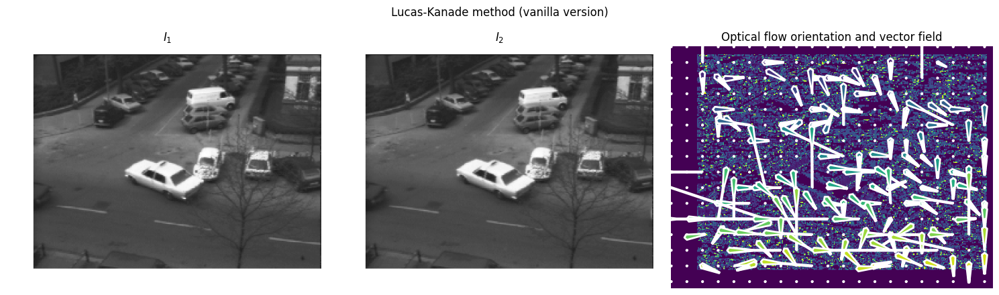

In [86]:
window_size = 3
tau = 0.01
# Running the LK method
#u, v = np.zeros_like(I1), np.zeros_like(I1) # comment out this line with the proper call (below) when you are ready
u,v = optical_flow1(I1, I2, window_size=window_size)
display_optic_flow(I1, I2, -u, -v, "Lucas-Kanade method (vanilla version)") #-u, -v, cтрелки указывают откуда "пришел" пиксель, а не куда он "идет".
                                                                           #тоже что и развернуть shape = (0, u.shape[1], step), np.arange(0, u.shape[0]

#### I Experiment with different amounts of translation and find out up to which mangitudes LK fares well

1. Small Motions
The LK algorithm assumes that motions between consecutive frames are small. This means that the algorithm is most effective when objects move a small distance relative to the size of the analysis window. This is because the algorithm is based on the first-order approximation of intensity changes (gradients), which works well for small displacements.

Limitation: Practically, motions should be smaller than the size of the window (e.g., if the window is 5x5 pixels, motions should be less than 5 pixels).

2. Constant Intensity
The LK algorithm relies on the assumption of constant intensity, i.e., the brightness of the object remains constant between frames. This limitation may not hold true in cases of changes in illumination, transparent, or reflective objects.

3. Good Texture Coverage
The algorithm requires a sufficient amount of texture in the region of interest for successful gradient computation. In homogeneous image regions where noticeable intensity gradients are absent, the LK algorithm may fail.

4. Influence of Noise and Artifacts
The algorithm is sensitive to noise and artifacts in the image, as noise can significantly affect gradient calculations, leading to errors in optical flow computation.

5. Analysis Window
The size of the analysis window is also crucial. Too small windows may not capture enough motion information, especially in dynamic scenes. Too large windows may lead to errors when there are multiple independent motions within the window.


#### Regarding 6. Optic flow estimation — 2/2 what the function plot_optic_flow

This function will look better if filtered by mass, using a jet map. An example is provided above. plt.quiver(norm_u, norm_v, magnitude, scale=50, cmap='jet') norm_u = u / (magnitude + 1e-5)  norm_v = v / (magnitude + 1e-5). But without normalization of V U or reduction by coefficient or formula, the image will be more saturated.

#### 7 Complement this visual inspection e histogram of the magnitude of the optical flow

shape of magnitude (417, 555)
Min shape of magnitude 417


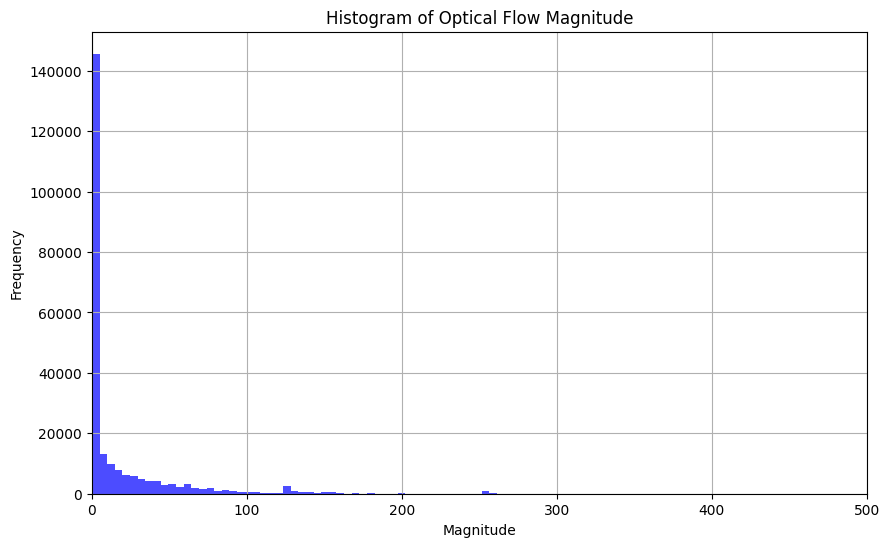

(417, 555)

In [87]:
magnitude = np.sqrt(u**2 + v**2)
z = magnitude.shape
bins = np.min(z)
title=("Histogram of Optical Flow Magnitude")
print("shape of magnitude", z)
print("Min shape of magnitude", bins)
# Создание гистограммы
plt.figure(figsize=(10, 6))
plt.hist(magnitude.ravel(), bins=bins, color='blue', alpha=0.7) #ravel() в библиотеке NumPy используется для "выравнивания" (flatten) многомерного массива в одномерный.
plt.title(title)
plt.xlabel('Magnitude')
plt.ylabel('Frequency')
plt.grid(True)
plt.xlim(0, 500)  # Ограничение для оси X
plt.show()
z

#### 8 Vary also the window size w

##### Testing Def Functions

In [88]:
def plot_optical_flow_magnitude_histogram(u, v, bins=30, title="Histogram of Optical Flow Magnitude"):
    """
    Plot a histogram of the magnitude of the optical flow vectors.

    Parameters:
        u (numpy.ndarray): Horizontal components of the optical flow.
        v (numpy.ndarray): Vertical components of the optical flow.
        bins (int): Number of bins in the histogram.
        title (str): Title of the histogram plot.
    """
    # Вычисление магнитуды оптического потока
    magnitude = np.sqrt(u**2 + v**2)

    # Создание гистограммы
    plt.figure(figsize=(10, 6))
    plt.hist(magnitude.ravel(), bins=bins, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel('Magnitude')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()



In [89]:
def plot_optical_flow_Vector(u, v, title="Optical Flow Vectors"):
    # Рассчитываем магнитуду потока
    magnitude = np.sqrt(u**2 + v**2)

    # Нормализуем векторы
    norm_u = u
    norm_v = v

    # Создаем график
    plt.figure(figsize=(10, 10))
    plt.quiver(norm_u, norm_v, magnitude, scale=50, cmap='jet')
    plt.title('Optical Flow Vectors')
    plt.axis('off')
    plt.imshow(magnitude, cmap='gray', interpolation='nearest')
    plt.colorbar(label='Magnitude of flow')
    plt.show()

##### Exe  Def Functions and run Test for W =  3 to 30

In [90]:
def plot_optical_flow_vector(u, v, ax, title):
     # Рассчитываем магнитуду потока
    magnitude = np.sqrt(u**2 + v**2)

    # Нормализуем векторы
    norm_u = u
    norm_v = v

    # Создаем график
    ax.quiver(norm_u, norm_v, magnitude, scale=50, cmap='jet')
    ax.imshow(magnitude, cmap='gray', interpolation='nearest')
    ax.set_title(title)
    ax.set_title(title)

In [91]:
def plot_optical_flow_magnitude_histogram(u, v, ax, bins, title):
    # Вычисление магнитуды оптического потока
    magnitude = np.sqrt(u**2 + v**2)
    ax.hist(magnitude.ravel(), bins=bins, color='blue', alpha=0.7)
    ax.set_title(title)
    ax.set_xlabel('Magnitude')
    ax.set_ylabel('Frequency')

In [92]:
def run_experiments_and_plot(I1, I2, tau):

    # Фигура для всех сабплотов
    fig = plt.figure(figsize=(12, 100))  # Установите размер, подходящий под количество сабплотов

    for i, window_size in enumerate(range(3, 30)):
        ws = 3 + i
        # Вычисление оптического потока
        u, v = optical_flow(I1, I2, window_size=window_size, tau=tau)

        # Подготовка сабплота для векторного поля
        ax1 = fig.add_subplot(48, 2, 2*i+1)  # 48 рядов, 2 колонки, позиция i
        plot_optical_flow_vector(u, v, ax=ax1, title=f"Optical Flow Vectors - Window Size {ws}")

        # Подготовка сабплота для гистограммы магнитуды
        ax2 = fig.add_subplot(48, 2, 2*i+2)  # Следующая колонка
        plot_optical_flow_magnitude_histogram(u, v, ax=ax2, bins=30, title="Histogram of Optical Flow Magnitude")

    plt.tight_layout()
    plt.show()


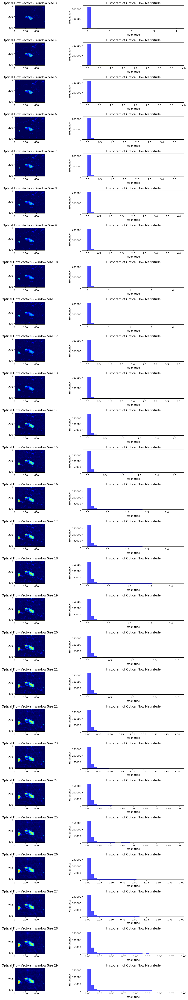

In [93]:
run_experiments_and_plot(I1, I2, tau=tau)

#### with the scale factor (both “zoom in” and “zoom out”) with rotations

“zoom in” and “zoom out” - OK. But rotation it makes no sense. Cores are configured for vertical and horizontal

In [94]:
I1 = images['taxi_frame000.png']
I2 = images['taxi_frame001.png']
I1 = np.array(I1)
I2 = np.array(I2)

In [95]:
def run_experiments_and_plotV2(I1, I2, tau, step): #Dif from run_experiments_and_plot - control step of window

    # Фигура для всех сабплотов
    fig = plt.figure(figsize=(12, 100))  # Установите размер, подходящий под количество сабплотов

    for i, window_size in enumerate(range(3, 30, step)):
        ws = 3 + i*step
        # Вычисление оптического потока
        u, v = optical_flow(I1, I2, window_size=window_size, tau=tau)

        # Подготовка сабплота для векторного поля
        ax1 = fig.add_subplot(48, 2, 2*i+1)  # 48 рядов, 2 колонки, позиция i
        plot_optical_flow_vector(u, v, ax=ax1, title=f"Optical Flow Vectors - Window Size {ws}")

        # Подготовка сабплота для гистограммы магнитуды
        ax2 = fig.add_subplot(48, 2, 2*i+2)  # Следующая колонка
        plot_optical_flow_magnitude_histogram(u, v, ax=ax2, bins=30, title="Histogram of Optical Flow Magnitude")

    plt.tight_layout()
    plt.show()

In [96]:
def scale_and_rotate_images_and_run(I1_original, I2_original, tau):
    scales = np.arange(0.5, 2, 0.5)  # Масштаб
    angles = np.arange(0, 361, 45)  # Углы от 0 до 360 с шагом 45

    for scale in scales:
        # Изменение масштаба изображений
        I1_scaled = cv2.resize(I1_original, None, fx=scale, fy=scale, interpolation=cv2.INTER_LINEAR)
        I2_scaled = cv2.resize(I2_original, None, fx=scale, fy=scale, interpolation=cv2.INTER_LINEAR)

        for angle in angles:
            # Вращение изображений
            M = cv2.getRotationMatrix2D((I1_scaled.shape[1] / 2, I1_scaled.shape[0] / 2), angle, 1)
            I1_rotated = cv2.warpAffine(I1_scaled, M, (I1_scaled.shape[1], I1_scaled.shape[0]))
            I2_rotated = cv2.warpAffine(I2_scaled, M, (I2_scaled.shape[1], I2_scaled.shape[0]))

            # Запуск экспериментов с оптическим потоком
            print(f"Running experiments for scale {scale} and rotation {angle} degrees")
            run_experiments_and_plotV2(I1_rotated, I2_rotated, tau, 5)


Running experiments for scale 0.5 and rotation 0 degrees


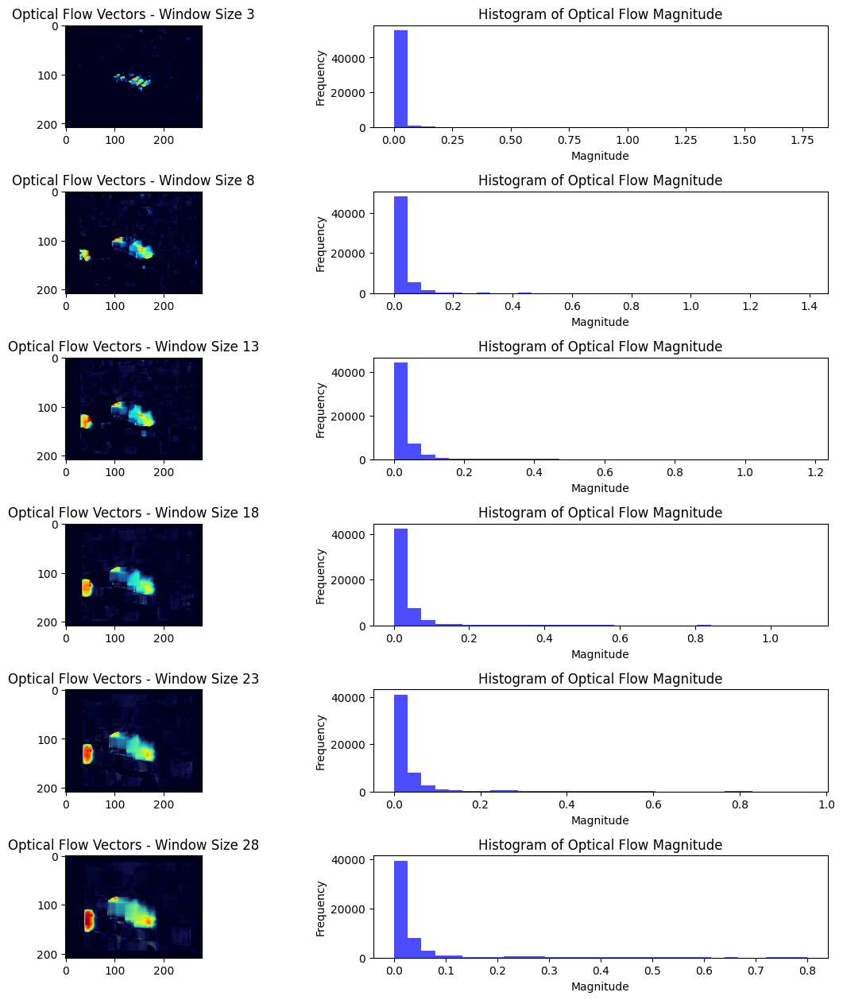

Running experiments for scale 0.5 and rotation 45 degrees


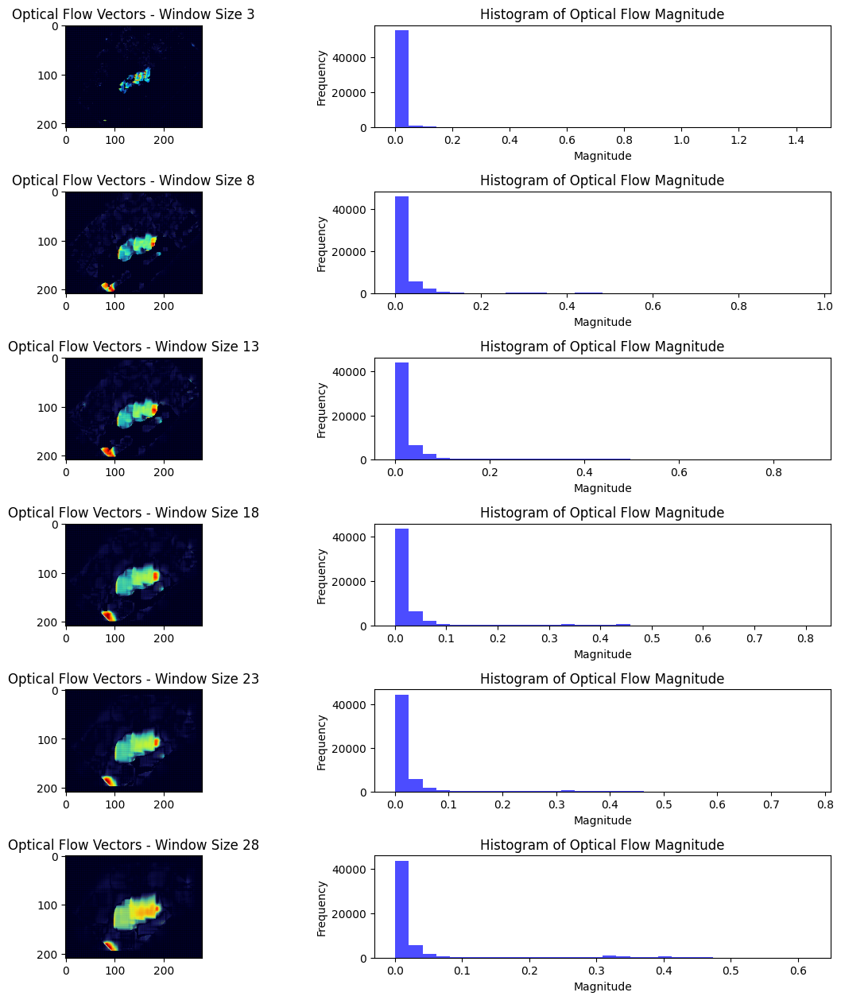

Running experiments for scale 0.5 and rotation 90 degrees


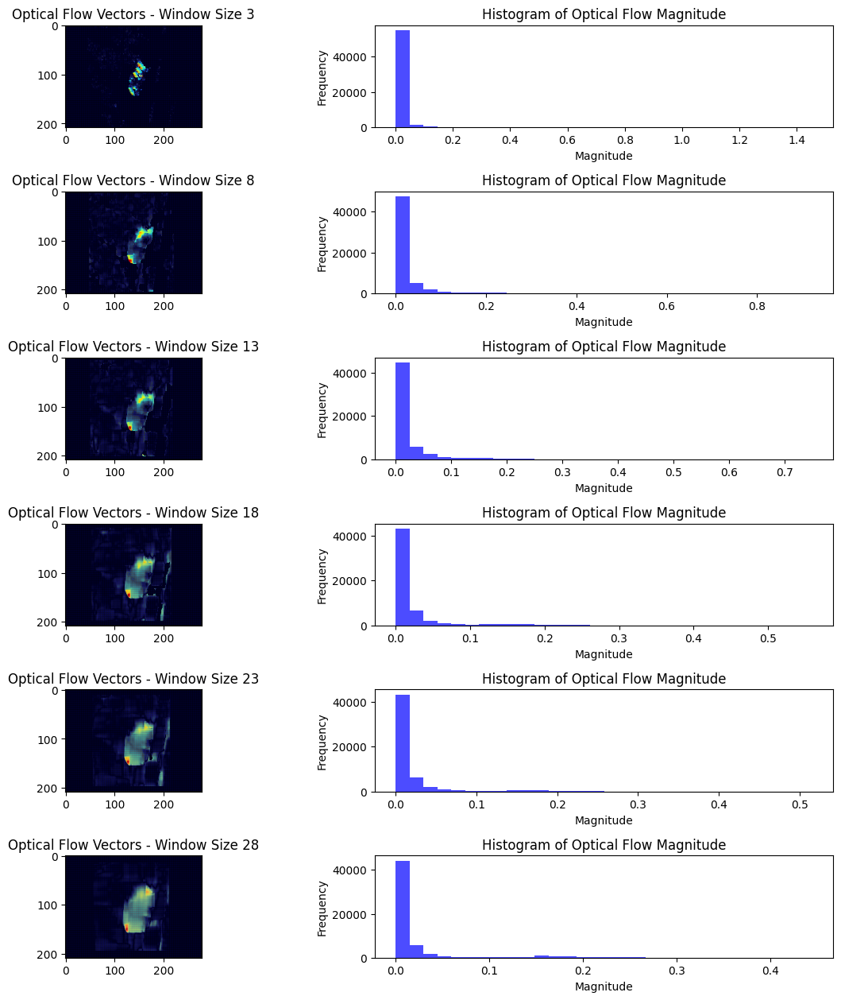

Running experiments for scale 0.5 and rotation 135 degrees


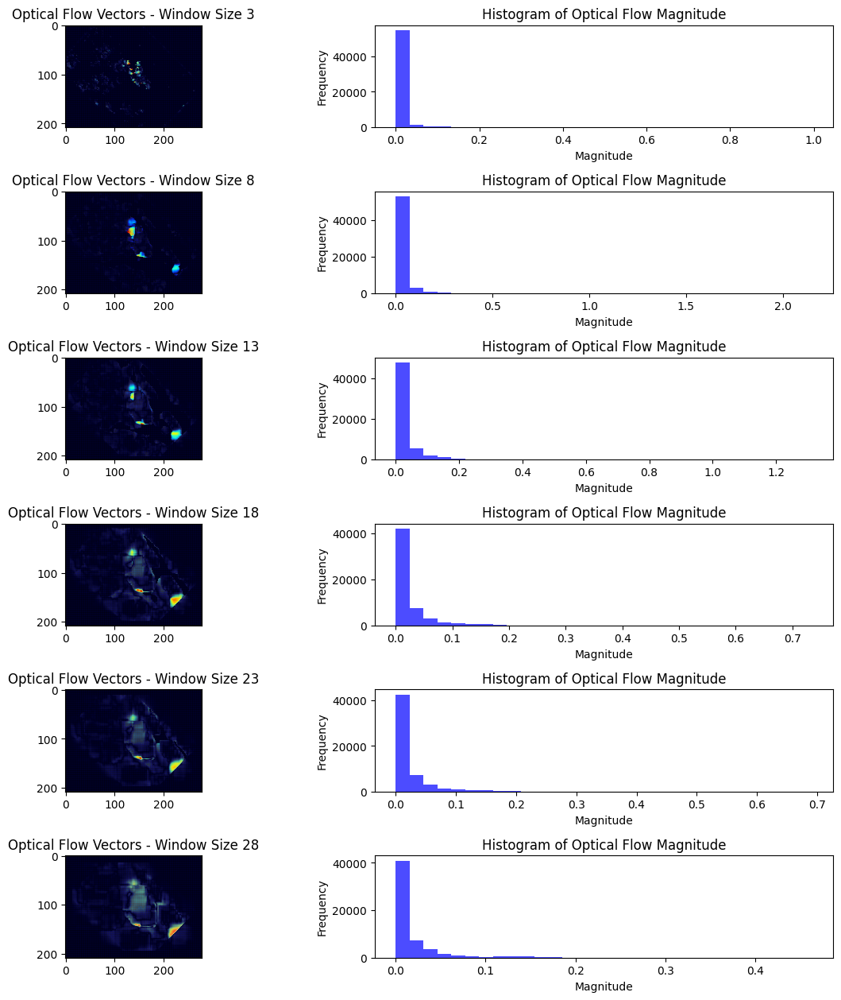

Running experiments for scale 0.5 and rotation 180 degrees


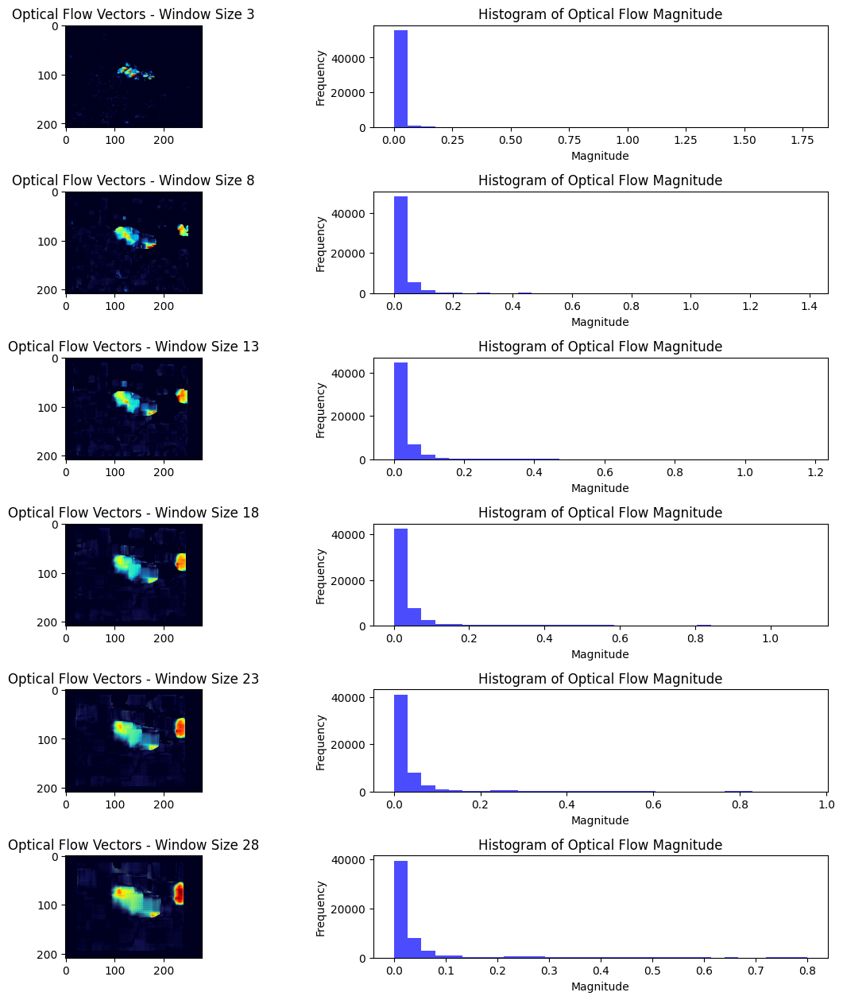

Running experiments for scale 0.5 and rotation 225 degrees


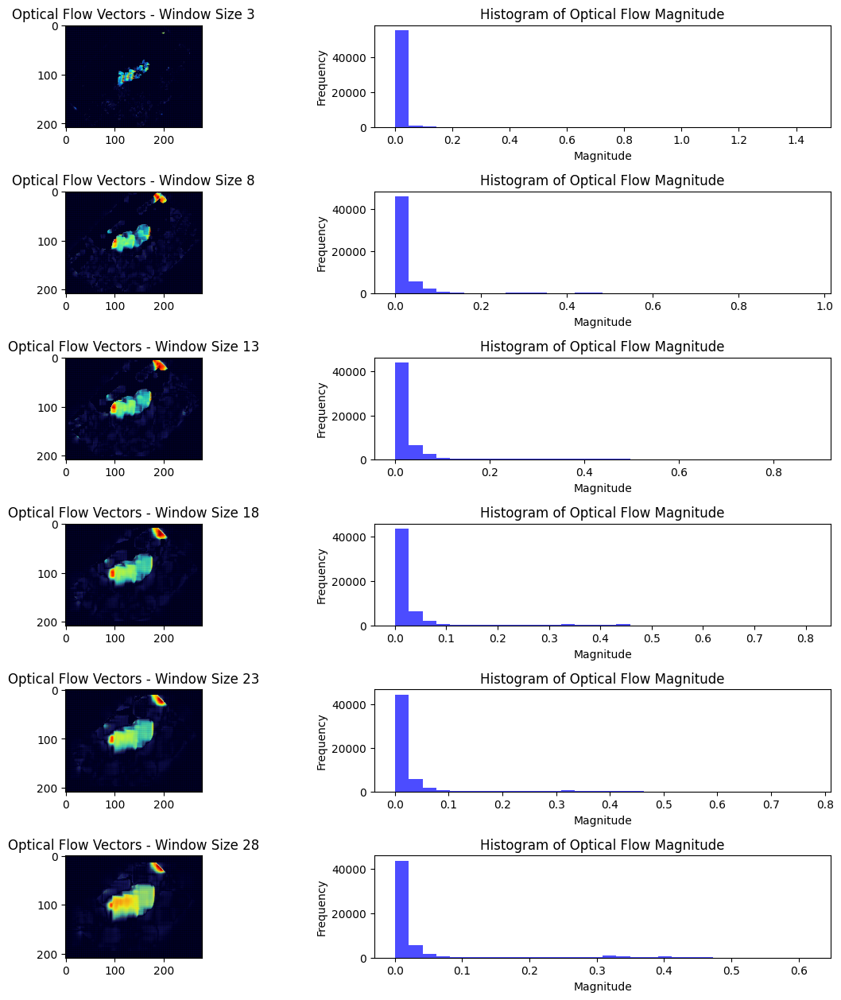

Running experiments for scale 0.5 and rotation 270 degrees


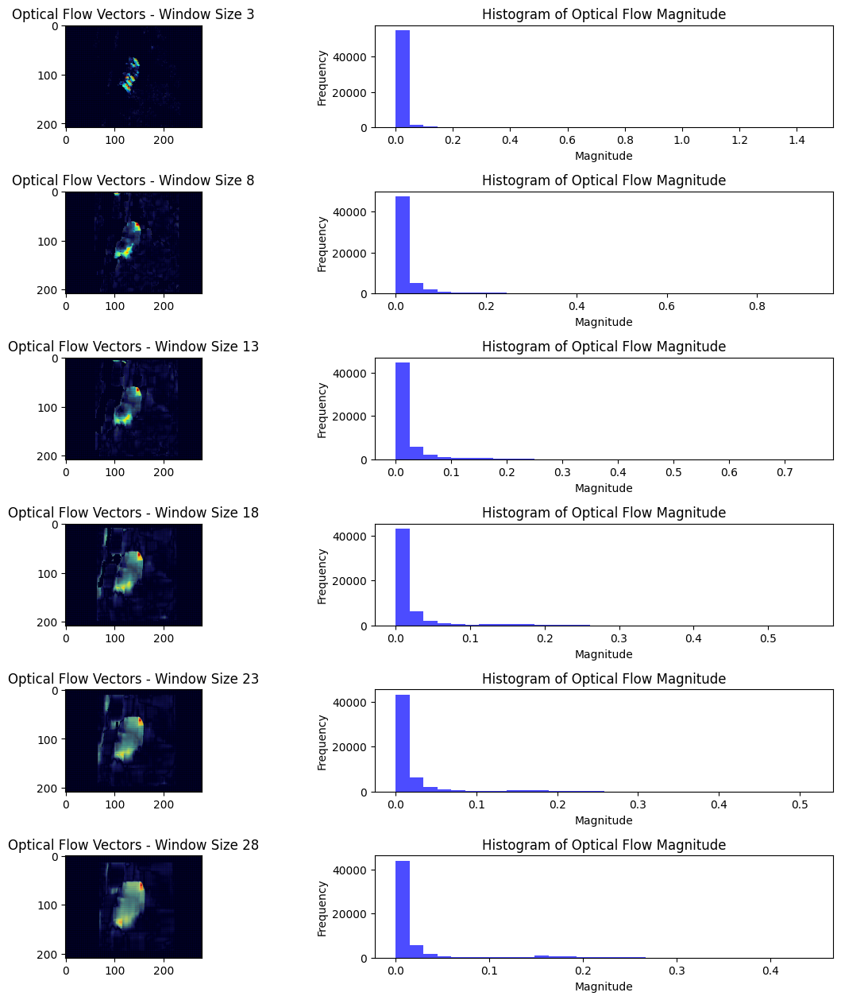

Running experiments for scale 0.5 and rotation 315 degrees


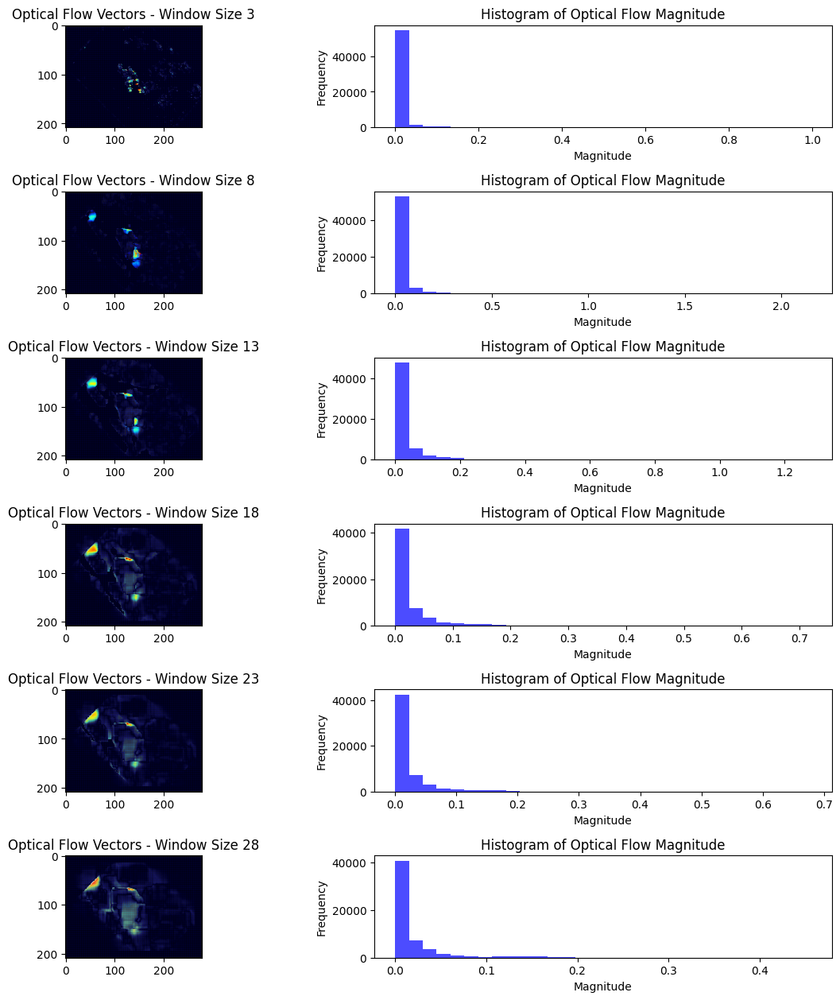

Running experiments for scale 0.5 and rotation 360 degrees


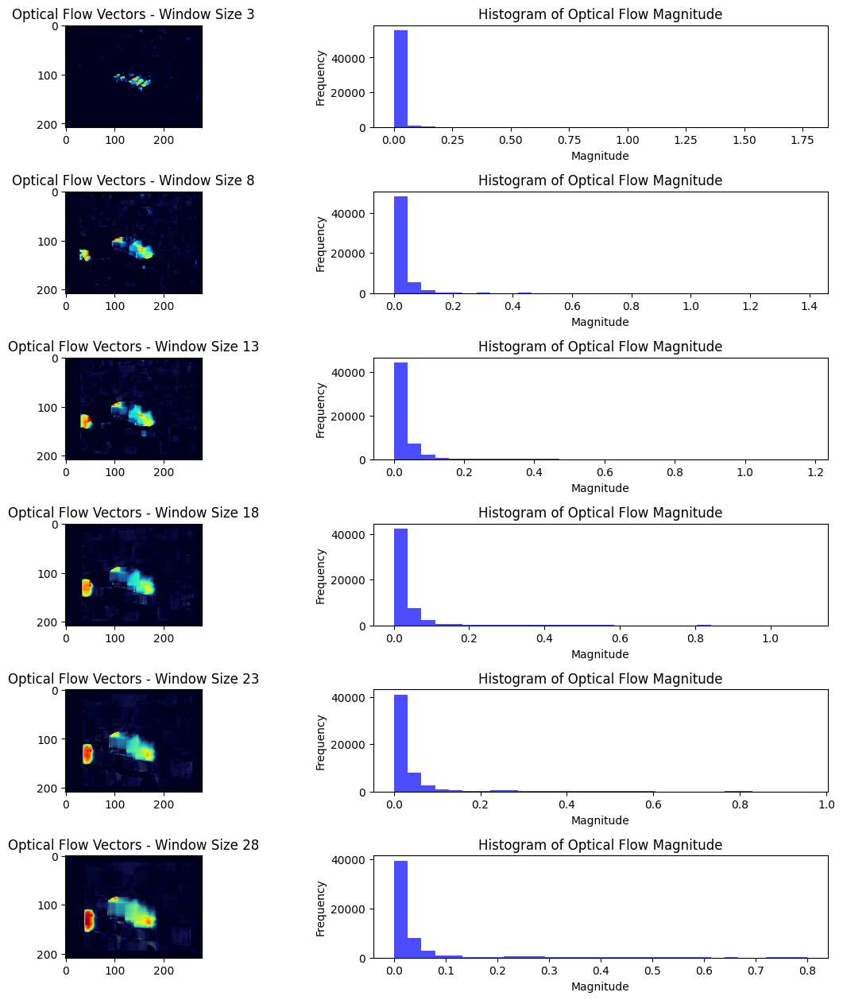

Running experiments for scale 1.0 and rotation 0 degrees


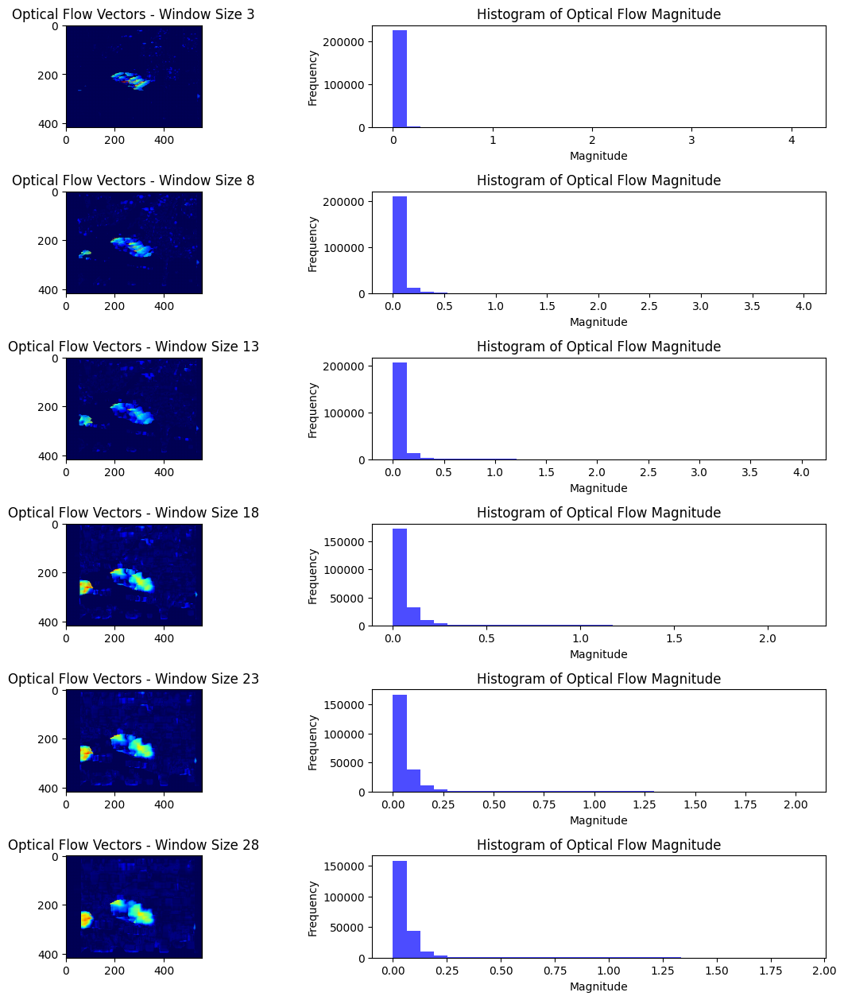

Running experiments for scale 1.0 and rotation 45 degrees


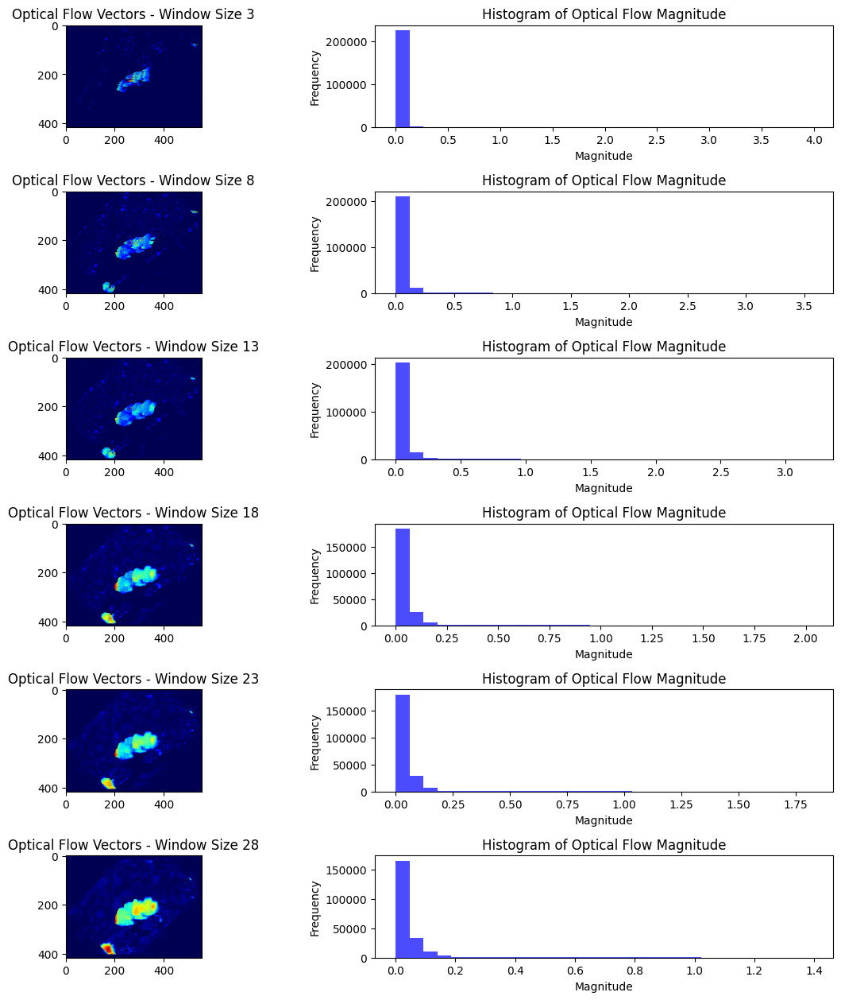

Running experiments for scale 1.0 and rotation 90 degrees


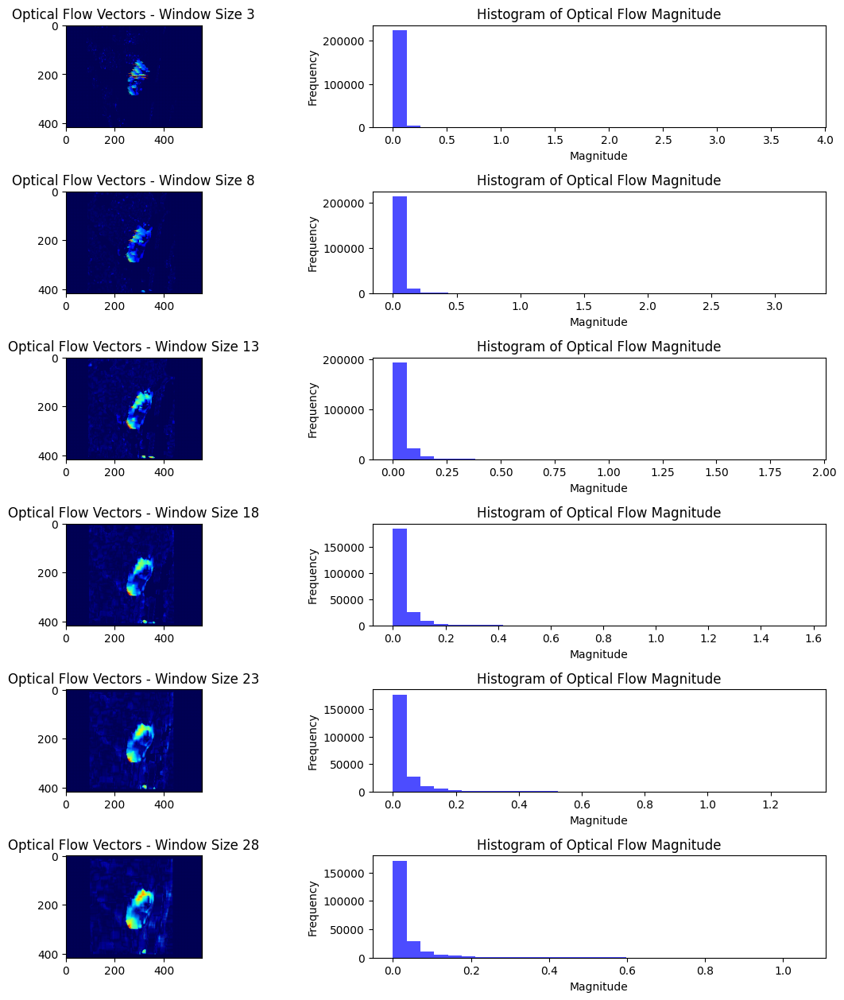

Running experiments for scale 1.0 and rotation 135 degrees


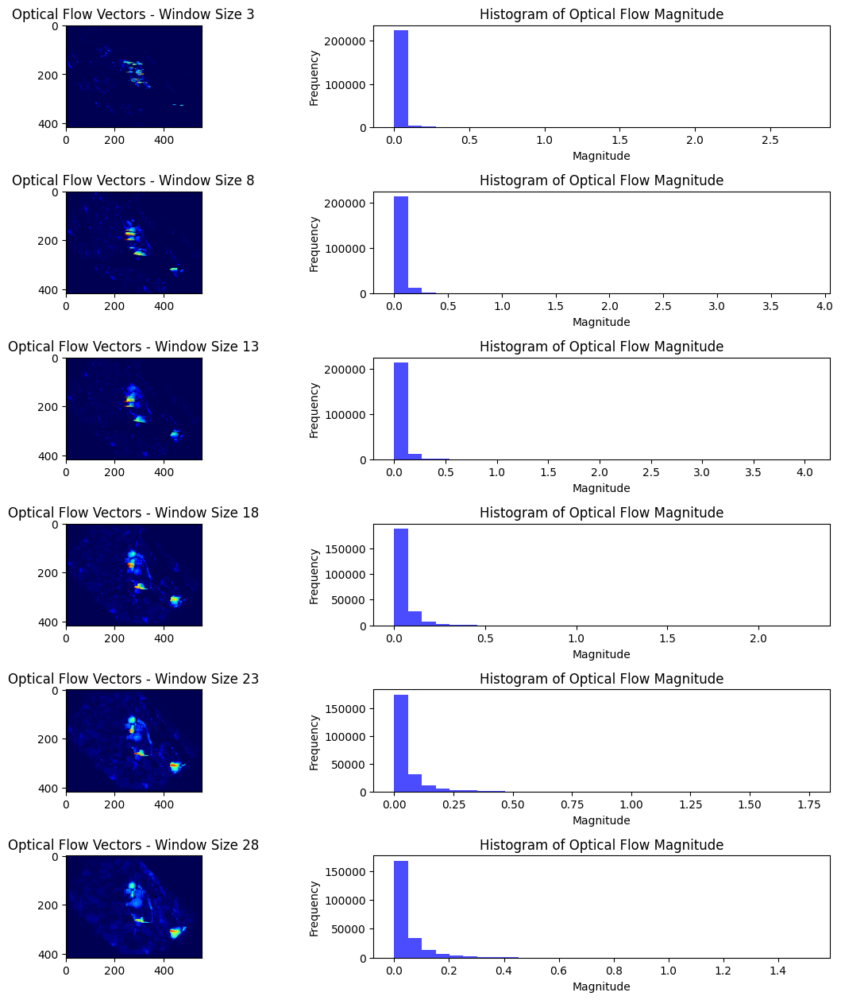

Running experiments for scale 1.0 and rotation 180 degrees


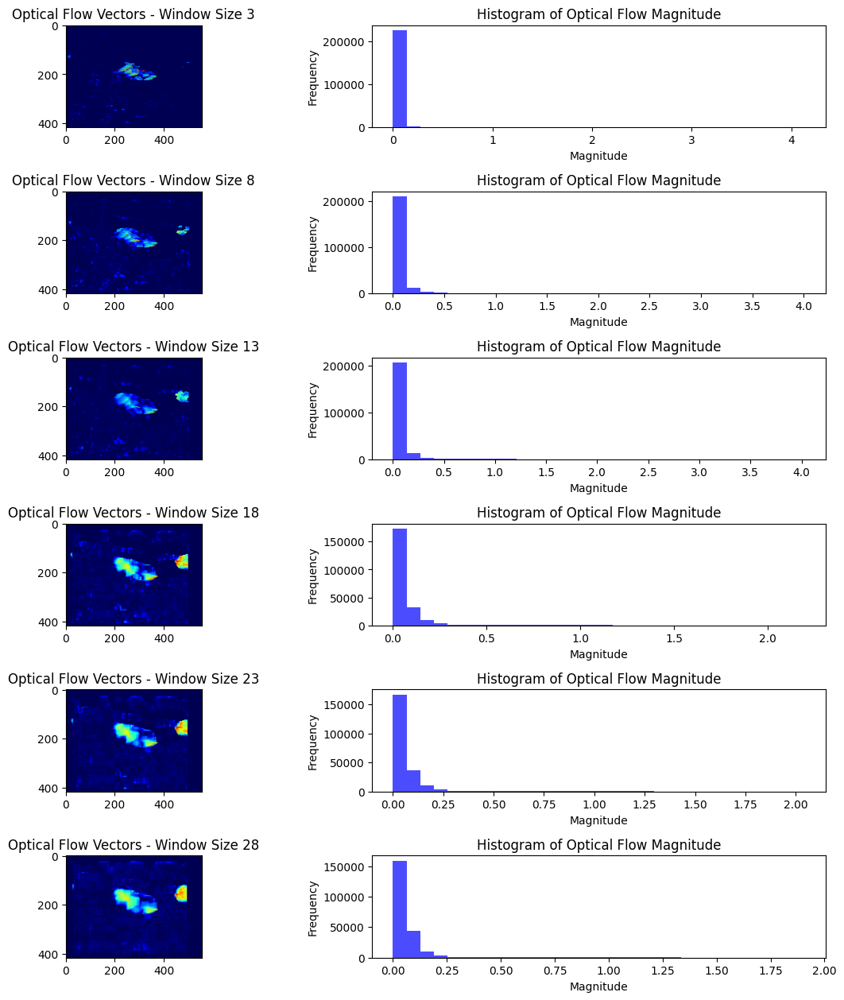

Running experiments for scale 1.0 and rotation 225 degrees


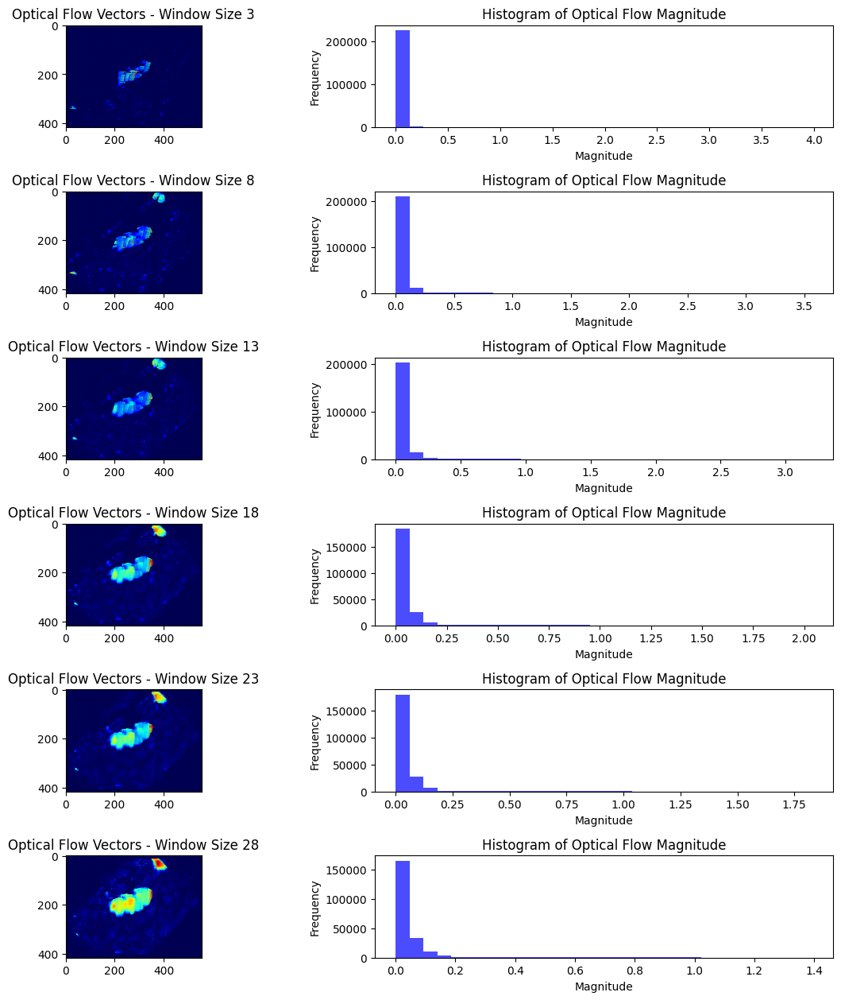

Running experiments for scale 1.0 and rotation 270 degrees


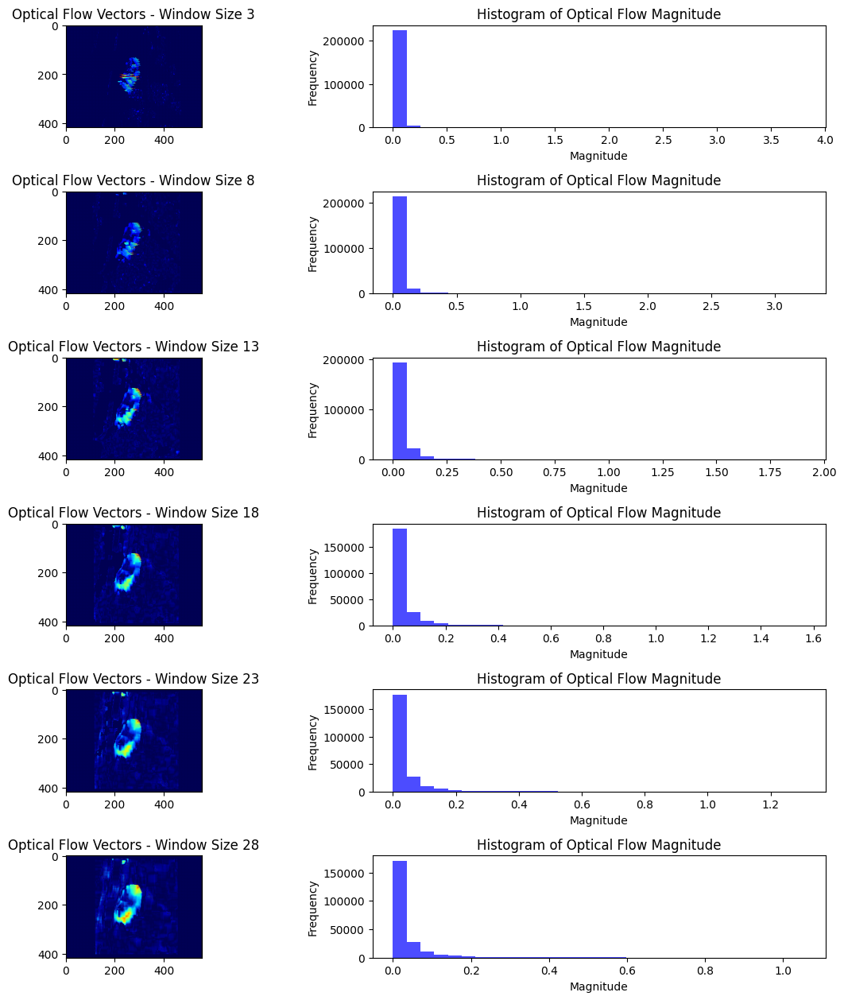

Running experiments for scale 1.0 and rotation 315 degrees


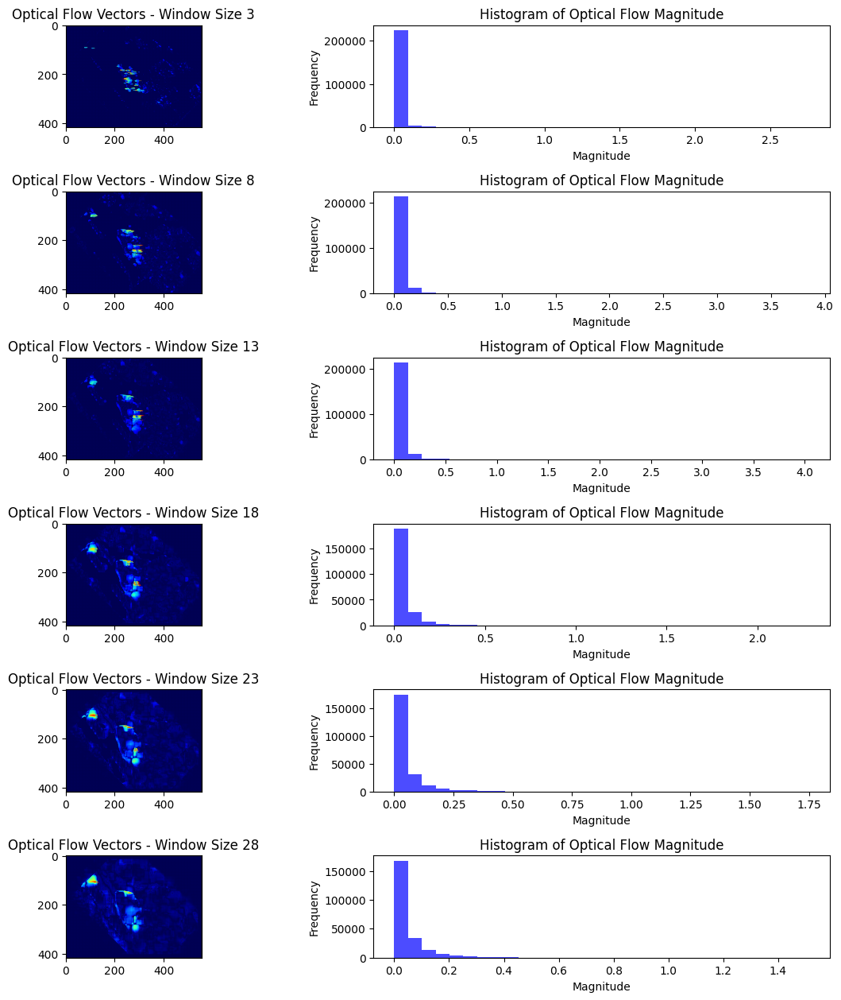

Running experiments for scale 1.0 and rotation 360 degrees


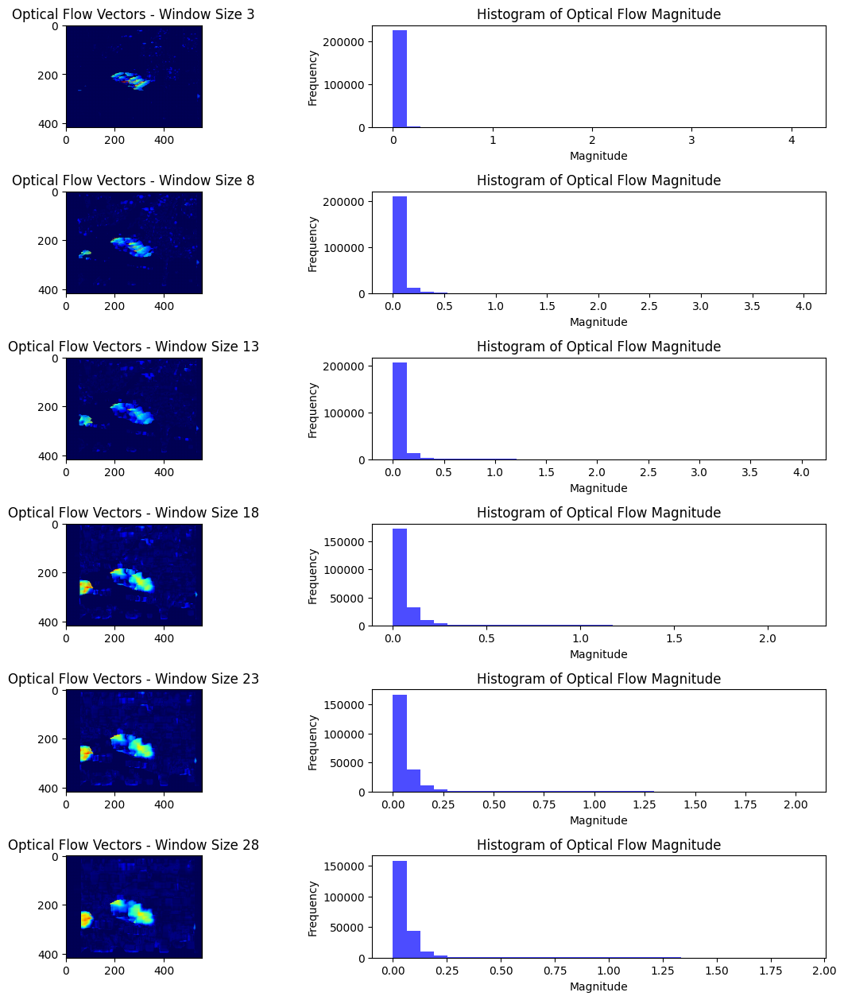

Running experiments for scale 1.5 and rotation 0 degrees


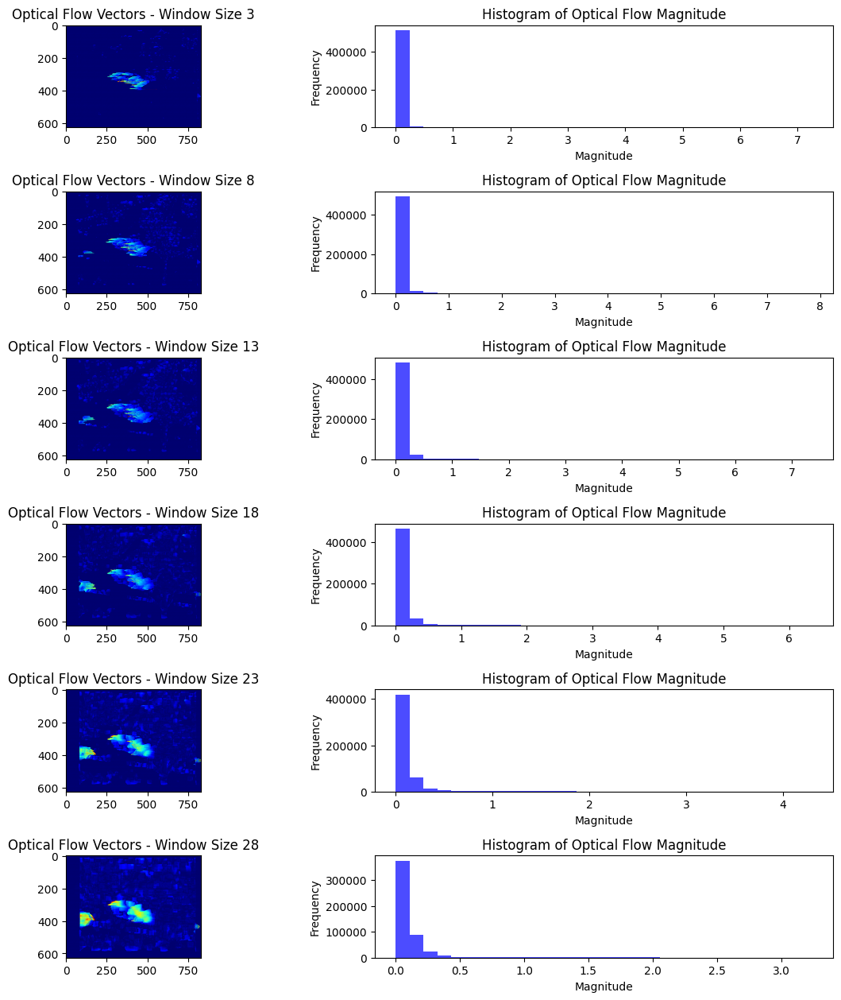

Running experiments for scale 1.5 and rotation 45 degrees


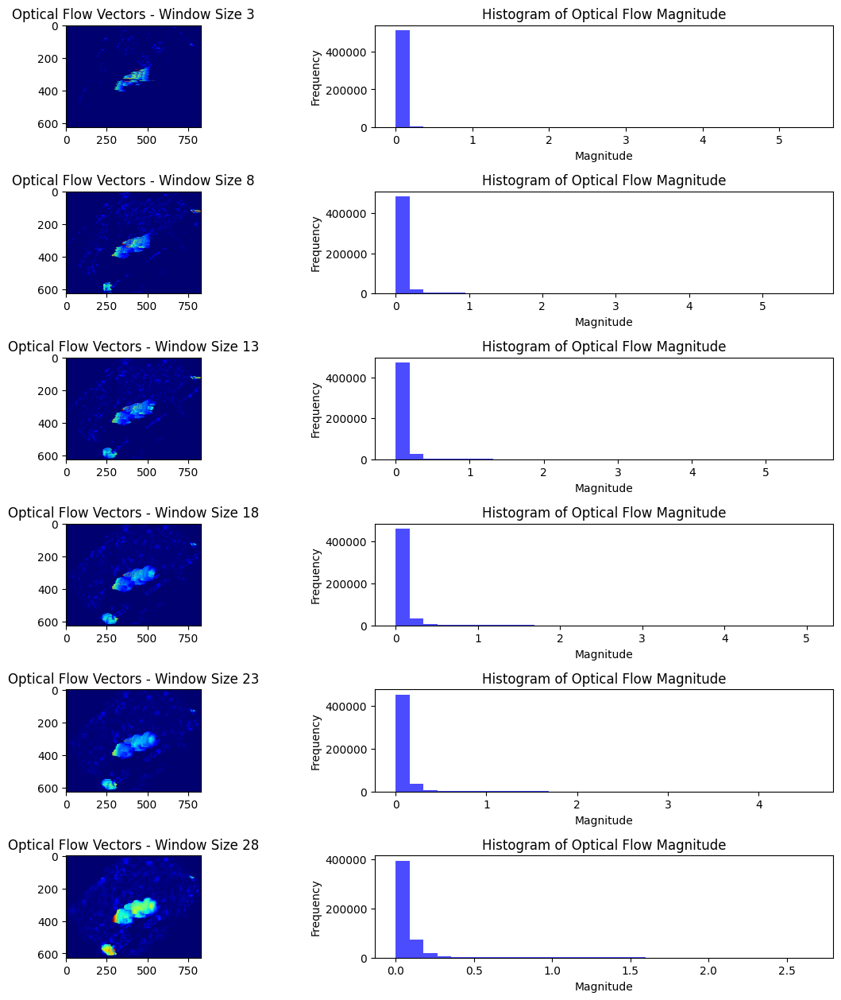

Running experiments for scale 1.5 and rotation 90 degrees


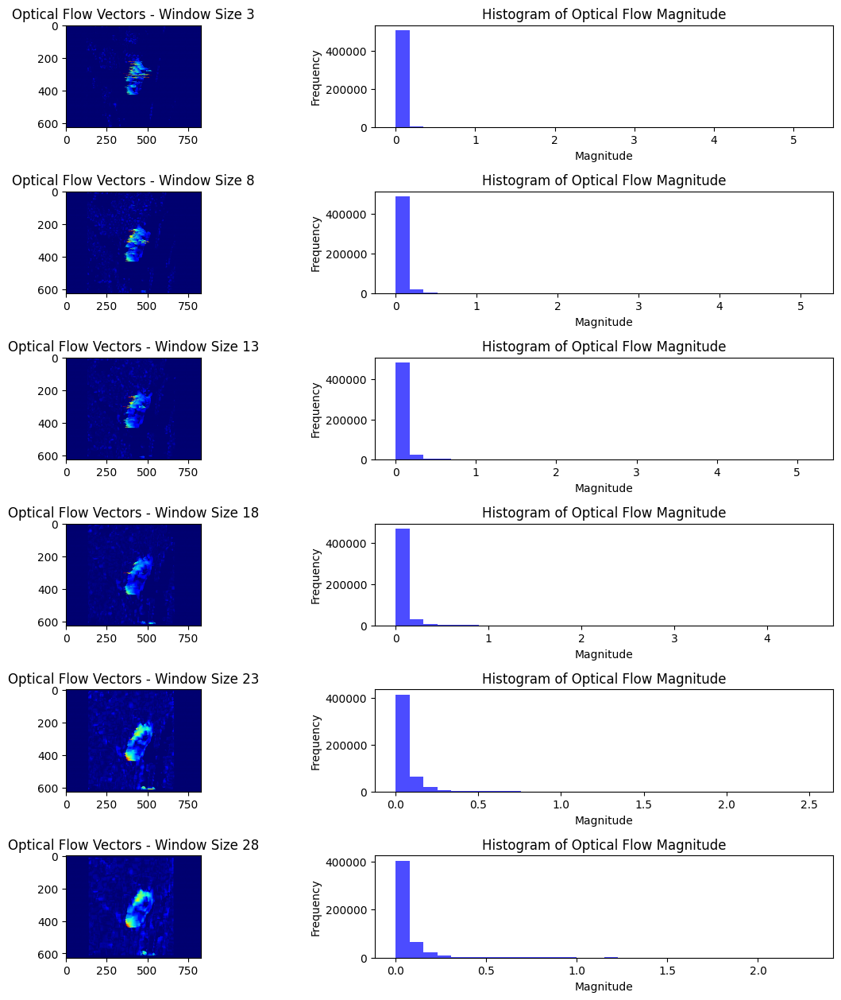

Running experiments for scale 1.5 and rotation 135 degrees


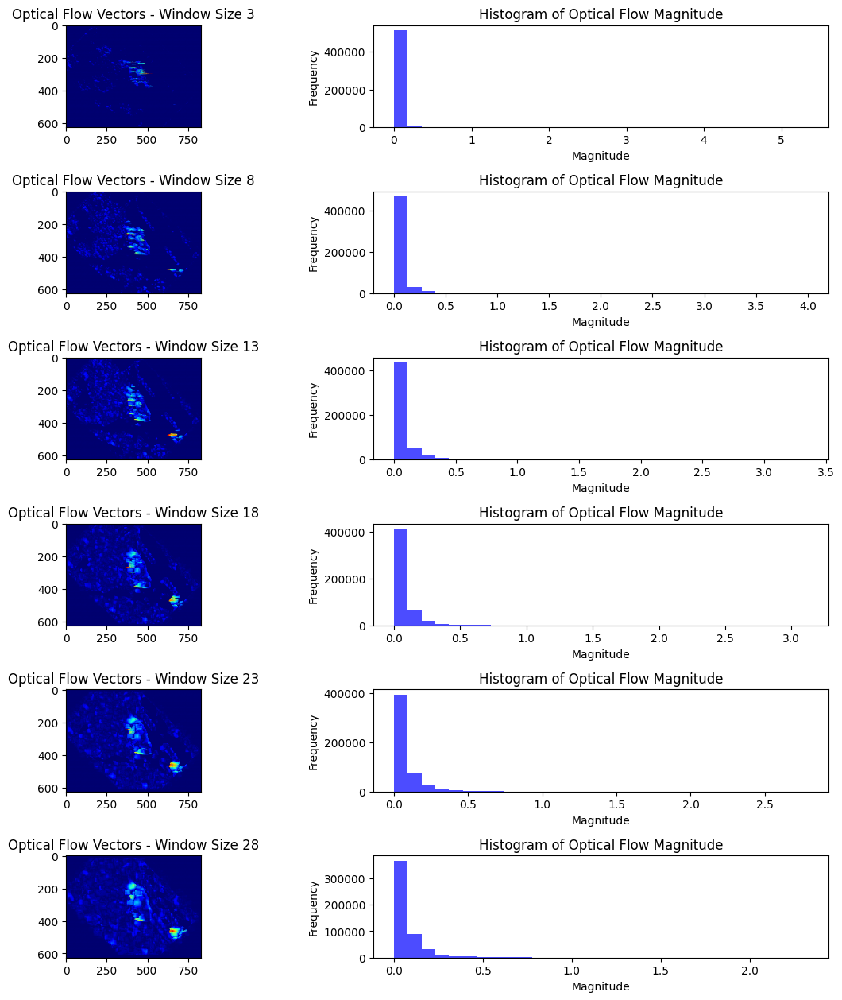

Running experiments for scale 1.5 and rotation 180 degrees


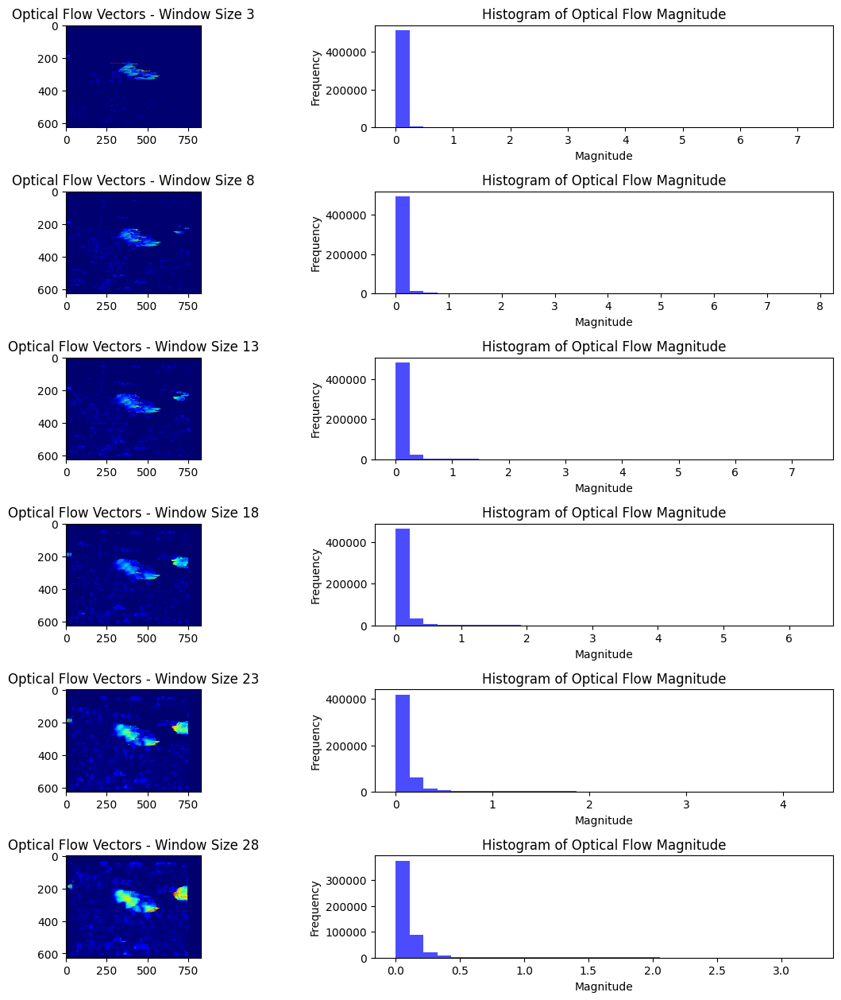

Running experiments for scale 1.5 and rotation 225 degrees


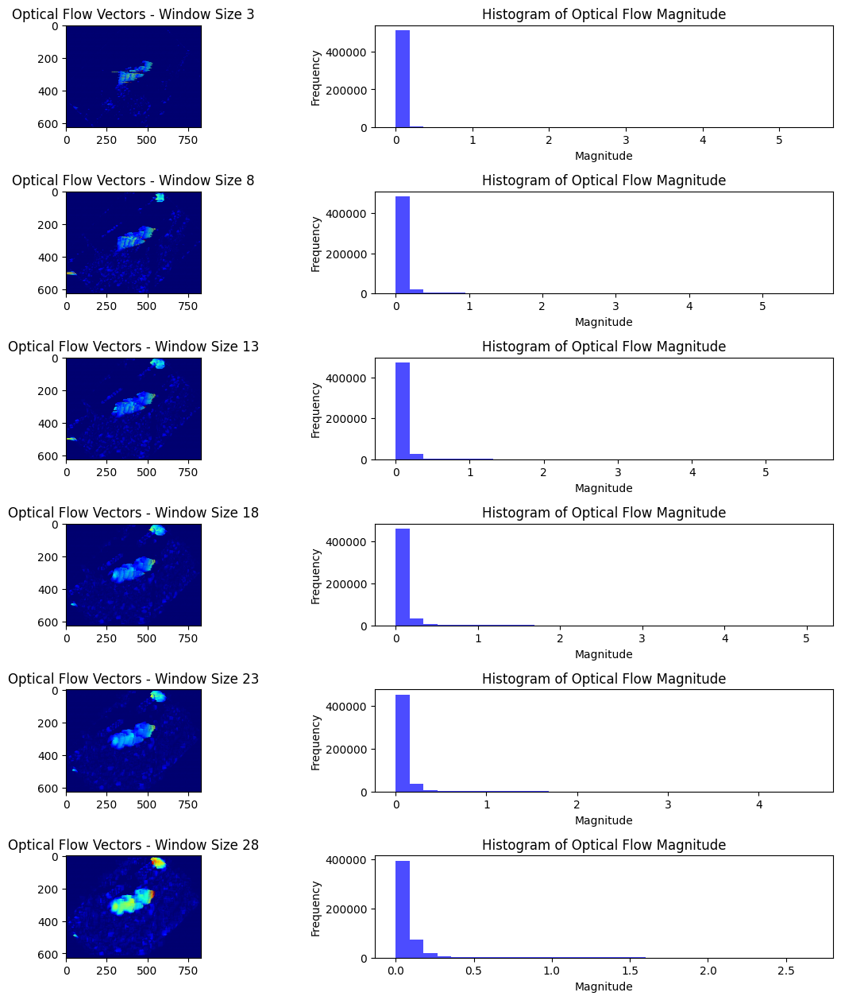

Running experiments for scale 1.5 and rotation 270 degrees


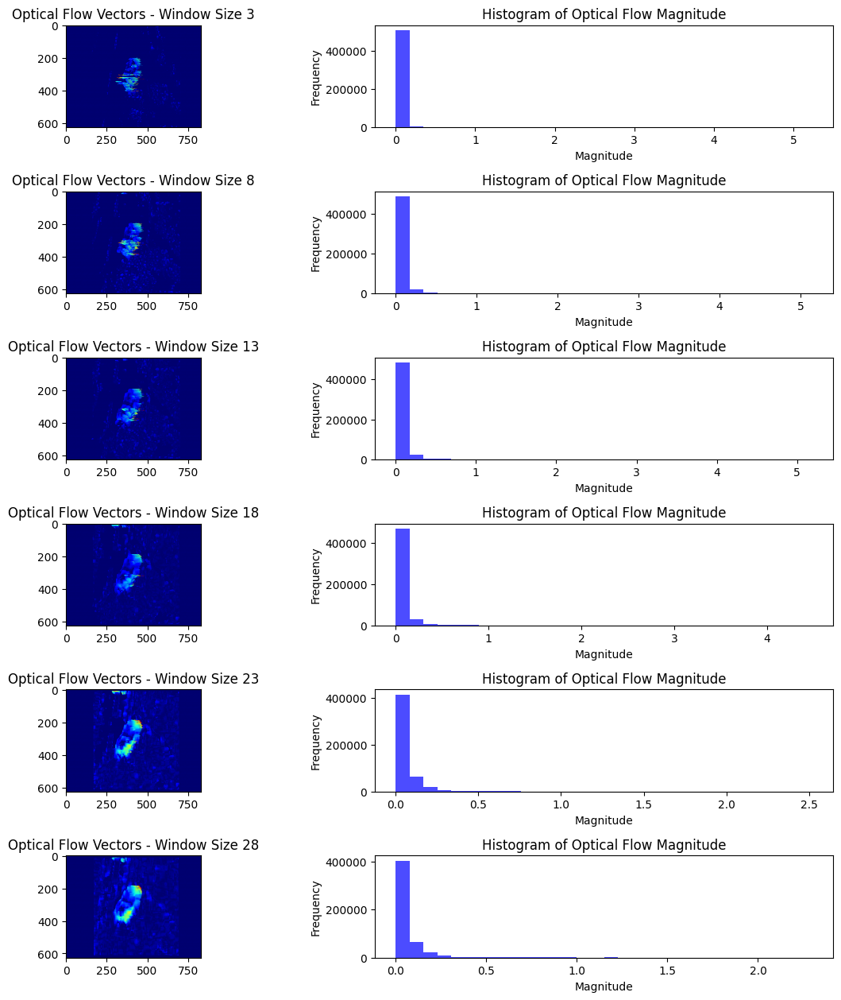

Running experiments for scale 1.5 and rotation 315 degrees


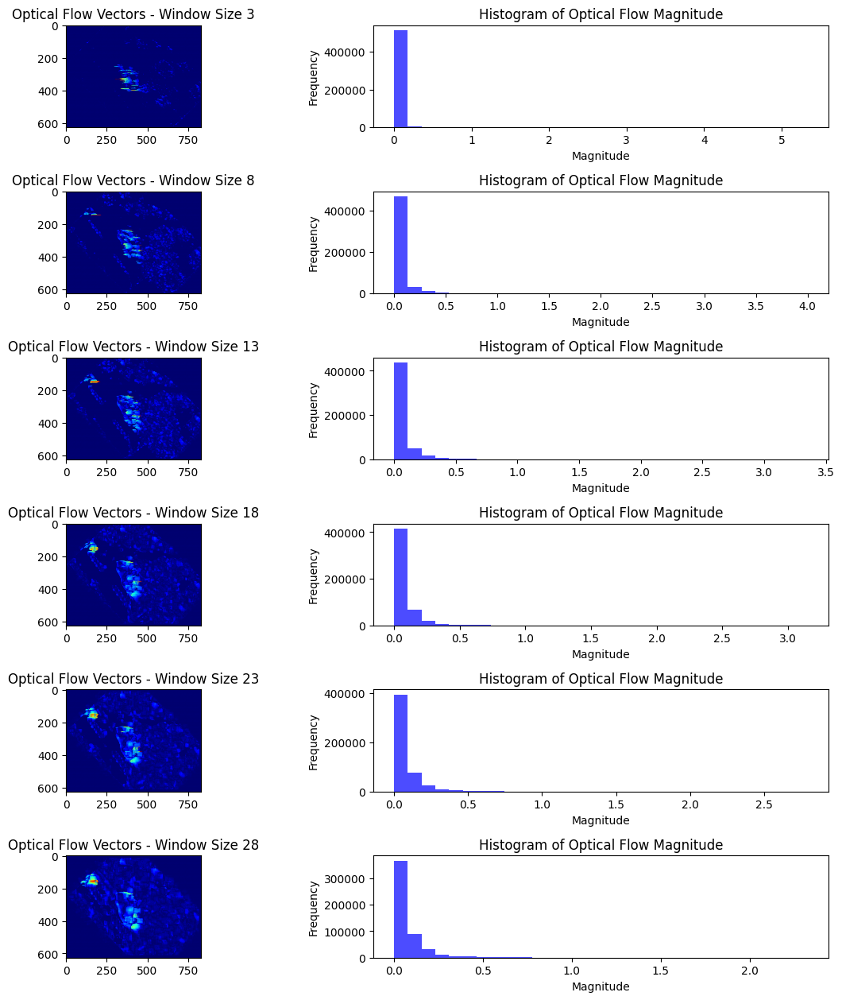

Running experiments for scale 1.5 and rotation 360 degrees


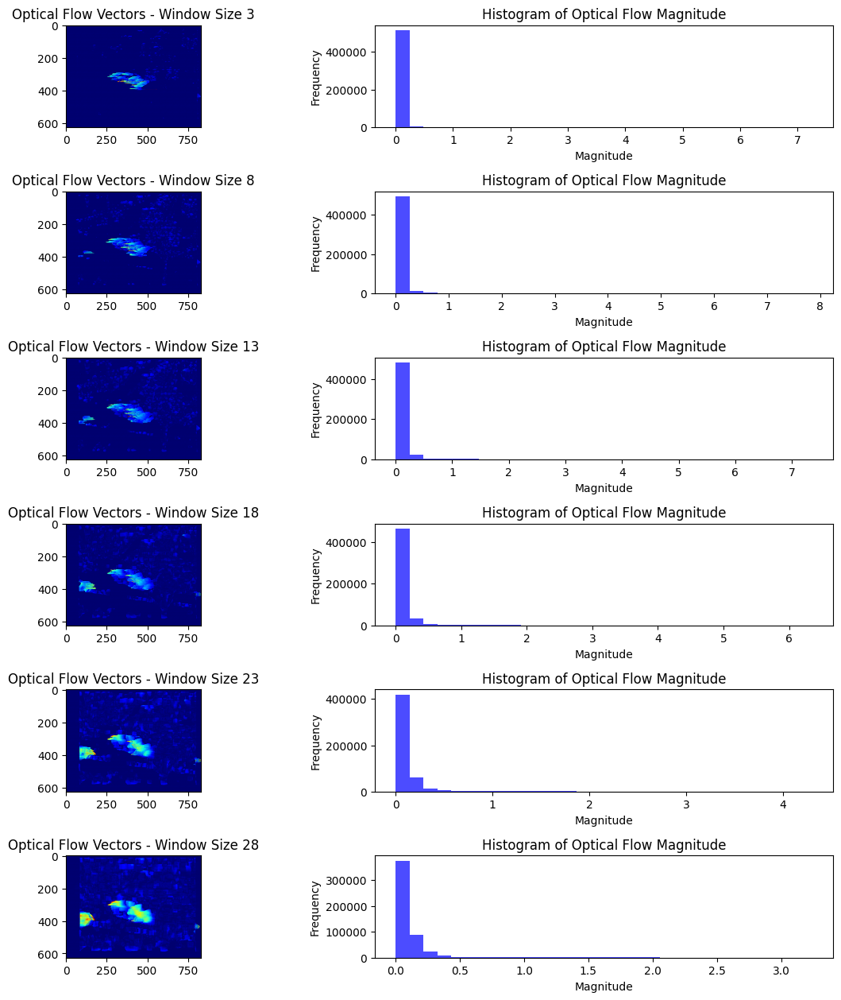

In [97]:
 scale_and_rotate_images_and_run(I1, I2, tau)

### 3. Real sequences

Changing the parameter τ:

Increasing the threshold value τ
can help improve the algorithm's robustness to noise and irregular motions, reducing the impact of small, less significant movements.


Allredy Done uppper

process_images_from_folder_Te(folder_path)

